# Preliminary

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:60% !important; }</style>"))

In [5]:
# For collapsable headings, table of contents

# !pip install jupyter_contrib_nbextensions
# !jupyter contrib nbextension install --user
# !pip install jupyter_nbextensions_configurator
# !jupyter nbextensions_configurator enable --user

In [6]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sklearn import preprocessing

In [7]:
!ls

backup	       data_7000-20191105T200553Z-001  label.csv  perprocess.ipynb
Clean_1.ipynb  data_7000_new.csv	       Misc	  train.csv


In [8]:
def print_img(img_name, img_size=[18,10]):
    image_path = os.path.join(root_data_folder, img_name)
    img = Image.open(image_path)
    plt.figure(figsize=img_size)
    plt.imshow(img)
    plt.show()

In [9]:
root_data_folder = "data_7000-20191105T200553Z-001/data_7000"
data = pd.read_csv('data_7000_new.csv', header=None)

print(data.shape)
data.head().transpose()

(6601, 9)


,0,1,2,3,4
0,10_year_2r94rv.jpg,10_year_10-year-challenge_1547788782.jpeg,10_year_10yearchallenge-5c75f8b946e0fb0001edc7...,10_year_10-year-challenge-sweet-dee-edition-40...,10_year_10-year-challenge-with-no-filter-47-hi...
1,https://i.imgflip.com/2r94rv.jpg,https://spiderimg.amarujala.com/assets/images/...,https://www.lifewire.com/thmb/8wNfd94_meE9X2cp...,https://pics.conservativememes.com/10-year-cha...,https://pics.me.me/10-year-challenge-with-no-f...
2,LOOK THERE MY FRIEND LIGHTYEAR NOW ALL SOHALIK...,The best of #10 YearChallenge! Completed in le...,Sam Thorne @Strippin ( Follow Follow Saw every...,10 Year Challenge - Sweet Dee Edition,10 YEAR CHALLENGE WITH NO FILTER 47 Hilarious ...
3,LOOK THERE MY FRIEND LIGHTYEAR NOW ALL SOHALIK...,The best of #10 YearChallenge! Completed in le...,Sam Thorne @Strippin ( Follow Follow Saw every...,10 Year Challenge - Sweet Dee Edition,10 YEAR CHALLENGE WITH NO FILTER 47 Hilarious ...
4,hilarious,not_funny,very_funny,very_funny,hilarious
5,general,general,not_sarcastic,twisted_meaning,very_twisted
6,not_offensive,not_offensive,not_offensive,very_offensive,very_offensive
7,not_motivational,motivational,not_motivational,motivational,not_motivational
8,very_positive,very_positive,positive,positive,neutral


# Remove NaNs

In [10]:
# Get NaN counts

print("NaN counts per Column")

for i in range(9):
    t = data.iloc[:,i]
    print("Column", i, ":",t[t.isna()].shape)
    
    if(i != 8): data.iloc[:,i] = t.fillna('nil')
    else: data.iloc[:,i] = t.fillna('neutral')

NaN counts per Column
Column 0 : (0,)
Column 1 : (0,)
Column 2 : (153,)
Column 3 : (9,)
Column 4 : (0,)
Column 5 : (0,)
Column 6 : (0,)
Column 7 : (7,)
Column 8 : (80,)


In [11]:
# Remove absurdities

t = data.iloc[:,8]
absurd_idx1 = np.where(t == 'positivechandler_Friday-Mood-AF.-meme-Friends-ChandlerBing.jpg')[0][0]
t[absurd_idx1] = 'none'
data.iloc[:,8] = t

absurd_idx2 = np.where(t == 'none')[0][0]
t[absurd_idx2] = 'neutral'
data.iloc[:,8] = t

print("Absurd data label index 1 :",absurd_idx1)
print("Absurd data label index 2 :",absurd_idx2)

Absurd data label index 1 : 670
Absurd data label index 2 : 670


In [12]:
# Looking at the absurd meme
# print_img(data.iloc[absurd_idx1,0])

# Cleaning the Labels

In [13]:
outlier_indices = []

Incorrect labels :  80


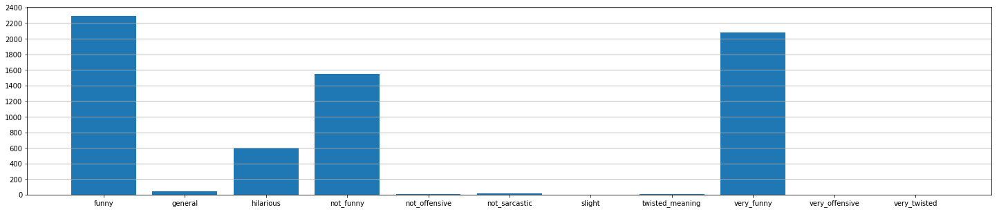

In [14]:
# Column 5
# Additional label : Hilariousness
# Reduce to : 4x ordinal [not_funny:0, hilarious:1, funny:2, very_funny:3]

cur_index = 4
incorrect_label_threshold_count = 100

# Get Column
t = data.iloc[:,cur_index]
labels, counts = np.unique(t, return_counts=True)

# Get Incorrect labels
incorrect_labels = []
incorrect_count = 0
for i, count in enumerate(counts):
    if(count < incorrect_label_threshold_count):
        incorrect_labels.append(labels[i])
        incorrect_count += count

# Get Outlier indices
cur_outlier_indices = []
for idx in range(len(data)):
    if(t[idx] in incorrect_labels):
        cur_outlier_indices.append(idx)
        
outlier_indices.append(cur_outlier_indices)
print("Incorrect labels : ", incorrect_count)


# Plot Graph
plt.figure(figsize=[25,5])
plt.bar(labels, counts)
plt.yticks(np.arange(0,2401,200))
plt.grid(axis='y')
plt.show()

Incorrect labels :  80


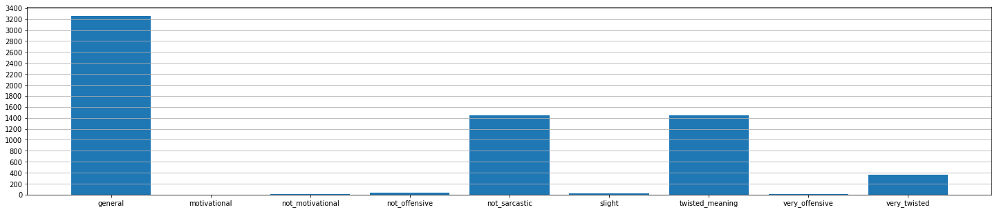

In [15]:
# Column 6
# Additional label : Intention
# Reduce to : 4x categorical [is_general, is_sarcastic, is_twisted, is_very_twisted]

cur_index = 5
incorrect_label_threshold_count = 100

# Get Column
t = data.iloc[:,cur_index]
labels, counts = np.unique(t, return_counts=True)

# Get Incorrect labels
incorrect_labels = []
incorrect_count = 0
for i, count in enumerate(counts):
    if(count < incorrect_label_threshold_count):
        incorrect_labels.append(labels[i])
        incorrect_count += count

# Get Outlier indices
cur_outlier_indices = []
for idx in range(len(data)):
    if(t[idx] in incorrect_labels):
        cur_outlier_indices.append(idx)
        
outlier_indices.append(cur_outlier_indices)
print("Incorrect labels : ", incorrect_count)

# Plot Graph
plt.figure(figsize=[25,5])
plt.bar(labels, counts)
plt.yticks(np.arange(0,3401,200))
plt.grid(axis='y')
plt.show()

Incorrect labels :  80


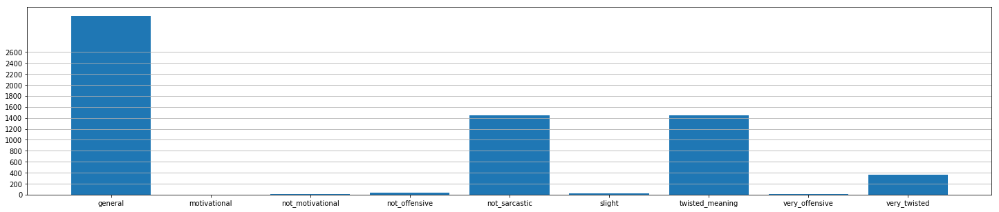

In [16]:
# Column 7
# Output label : Offensiveness
# Reduce to : 4x ordinal [not_offensive:0, slight:1, very_offensive:2, hateful_offensive:3]

cur_index = 6
incorrect_label_threshold_count = 100

# Get Incorrect labels
incorrect_labels = []
incorrect_count = 0
for i, count in enumerate(counts):
    if(count < incorrect_label_threshold_count):
        incorrect_labels.append(labels[i])
        incorrect_count += count

# Get Outlier indices
cur_outlier_indices = []
for idx in range(len(data)):
    if(t[idx] in incorrect_labels):
        cur_outlier_indices.append(idx)
        
outlier_indices.append(cur_outlier_indices)
print("Incorrect labels : ", incorrect_count)

# Plot Graph
plt.figure(figsize=[25,5])
plt.bar(labels, counts)
plt.yticks(np.arange(0,2601,200))
plt.grid(axis='y')
plt.show()

Incorrect labels :  80


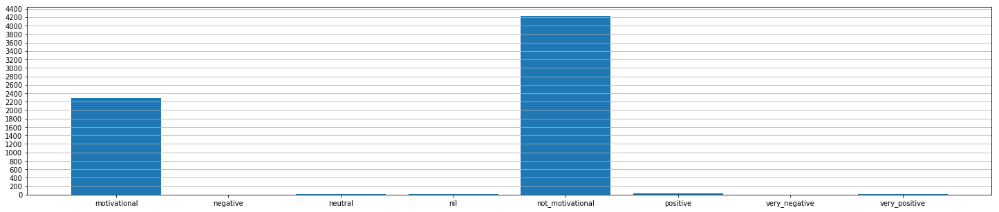

In [17]:
# Column 8
# Output label : isMotivational
# Reduce to : Boolean [isMotivational]

cur_index = 7
incorrect_label_threshold_count = 100

# Get Column
t = data.iloc[:,cur_index]
labels, counts = np.unique(t, return_counts=True)

# Get Incorrect labels
incorrect_labels = []
incorrect_count = 0
for i, count in enumerate(counts):
    if(count < incorrect_label_threshold_count):
        incorrect_labels.append(labels[i])
        incorrect_count += count

# Get Outlier indices
cur_outlier_indices = []
for idx in range(len(data)):
    if(t[idx] in incorrect_labels):
        cur_outlier_indices.append(idx)
        
outlier_indices.append(cur_outlier_indices)
print("Incorrect labels : ", incorrect_count)

# Plot Graph
plt.figure(figsize=[25,5])
plt.bar(labels, counts)
plt.yticks(np.arange(0,4401,200))
plt.grid(axis='y')
plt.show()

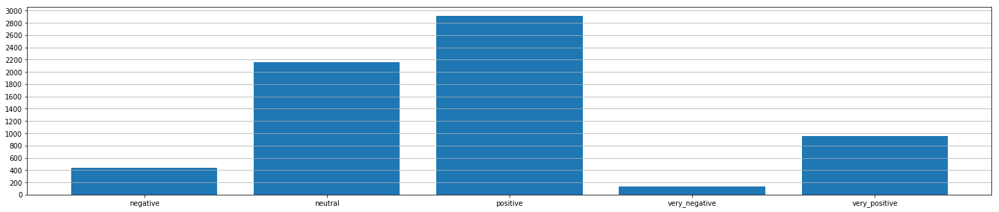

In [18]:
# Column 9
# Output label : Sentiment
# Reduce to : 5x Ordinal [very_negative:0, negative:1, neutral:2, postive:3, very_positive:4]

cur_index = 8

# Get Column
t = data.iloc[:,cur_index]
labels, counts = np.unique(t, return_counts=True)

# Plot Graph
plt.figure(figsize=[25,5])
plt.bar(labels, counts)
plt.yticks(np.arange(0,3001,200))
plt.grid(axis='y')
plt.show()

In [20]:
absurd_indices, absurd_counts = np.unique(outlier_indices[0] + outlier_indices[1] + outlier_indices[2] + outlier_indices[3], return_counts=True)

print("Counts of absurdities per incorrect data indice :")
print(absurd_counts)

print("\nAbsurd indices :")
print(absurd_indices)

Counts of absurdities per incorrect data indice :
[4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4
 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4
 4 4 4 4 4 4]

Absurd indices :
[ 117  174  351  434  578  587  601  667  684  772 1045 1167 1296 1304
 1355 1386 1490 1493 1651 1675 1888 1892 1982 1986 1992 2025 2044 2058
 2328 2576 2874 2923 2959 3042 3113 3342 3495 3536 3563 3598 3630 3670
 3674 3687 3698 3735 3774 3780 3940 4091 4143 4174 4312 4376 4544 4594
 4689 4943 4947 5060 5111 5144 5239 5251 5262 5382 5438 5465 5503 5700
 5817 5834 5952 5959 5994 6025 6105 6250 6360 6512]


# Absurd memes

In [21]:
# for absurd_idx in absurd_indices:
#     print_img(data.iloc[absurd_idx,0])

# Cleaning the Data

In [22]:
absurd_indices = [117, 174, 351, 434, 578, 587, 601, 667, 684, 772, 1045, 1167, 1296, 1304, 1355, 1386, 1490, 1493, 1651, 1675, 1888, 1892, 1982, 1986, 1992, 2025, 2044, 2058, 2328, 2576, 2874, 2923, 2959, 3042, 3113, 3342, 3495, 3536, 3563, 3598, 3630, 3670, 3674, 3687, 3698, 3735, 3774, 3780, 3940, 4091, 4143, 4174, 4312, 4376, 4544, 4594, 4689, 4943, 4947, 5060, 5111, 5144, 5239, 5251, 5262, 5382, 5438, 5465, 5503, 5700, 5817, 5834, 5952, 5959, 5994, 6025, 6105, 6250, 6360, 6512]

mask = np.ones(data.shape[0])
mask[absurd_indices] = 0

mask = np.asarray(mask, dtype=bool)
cdata = data[mask]
cdata = pd.DataFrame(cdata, dtype=str)
cdata = cdata.set_index(np.arange(0,len(cdata)))
cdata.head(5)

,0,1,2,3,4,5,6,7,8
0,10_year_2r94rv.jpg,https://i.imgflip.com/2r94rv.jpg,LOOK THERE MY FRIEND LIGHTYEAR NOW ALL SOHALIK...,LOOK THERE MY FRIEND LIGHTYEAR NOW ALL SOHALIK...,hilarious,general,not_offensive,not_motivational,very_positive
1,10_year_10-year-challenge_1547788782.jpeg,https://spiderimg.amarujala.com/assets/images/...,The best of #10 YearChallenge! Completed in le...,The best of #10 YearChallenge! Completed in le...,not_funny,general,not_offensive,motivational,very_positive
2,10_year_10yearchallenge-5c75f8b946e0fb0001edc7...,https://www.lifewire.com/thmb/8wNfd94_meE9X2cp...,Sam Thorne @Strippin ( Follow Follow Saw every...,Sam Thorne @Strippin ( Follow Follow Saw every...,very_funny,not_sarcastic,not_offensive,not_motivational,positive
3,10_year_10-year-challenge-sweet-dee-edition-40...,https://pics.conservativememes.com/10-year-cha...,10 Year Challenge - Sweet Dee Edition,10 Year Challenge - Sweet Dee Edition,very_funny,twisted_meaning,very_offensive,motivational,positive
4,10_year_10-year-challenge-with-no-filter-47-hi...,https://pics.me.me/10-year-challenge-with-no-f...,10 YEAR CHALLENGE WITH NO FILTER 47 Hilarious ...,10 YEAR CHALLENGE WITH NO FILTER 47 Hilarious ...,hilarious,very_twisted,very_offensive,not_motivational,neutral


[ 207 2542 2408 1364]


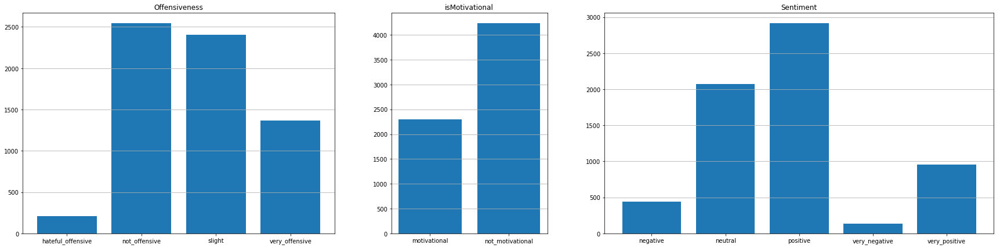

In [23]:
from matplotlib import gridspec

fig = plt.figure(figsize=[30,7])
gs = gridspec.GridSpec(1, 3, width_ratios=[4, 2, 5]) 

plt.subplot(gs[0])
plt.title('Offensiveness')
t = cdata.iloc[:,6]
labels, counts = np.unique(t, return_counts=True)
print(counts)
plt.bar(labels, counts)
plt.grid(axis='y') 

plt.subplot(gs[1])
plt.title('isMotivational')
t = cdata.iloc[:,7]
labels, counts = np.unique(t, return_counts=True)
plt.bar(labels, counts)
plt.grid(axis='y')

plt.subplot(gs[2])
plt.title('Sentiment')
t = cdata.iloc[:,8]
labels, counts = np.unique(t, return_counts=True)
plt.bar(labels, counts)
plt.grid(axis='y')

plt.show()

In [43]:
print("BaseLines :")
print(" Offensiveness : {:.4f}".format(len( cdata.iloc[:,6][cdata.iloc[:,6] == 'not_offensive']) / len(cdata)))
print(" isMotivational : {:.4f}".format(len( cdata.iloc[:,7][cdata.iloc[:,7] == 'not_motivational']) / len(cdata)))
print(" Sentiment : {:.4f}".format(len( cdata.iloc[:,8][cdata.iloc[:,8] == 'positive']) / len(cdata)))

BaseLines :
 Offensiveness : 0.3898
 isMotivational : 0.6485
 Sentiment : 0.4466


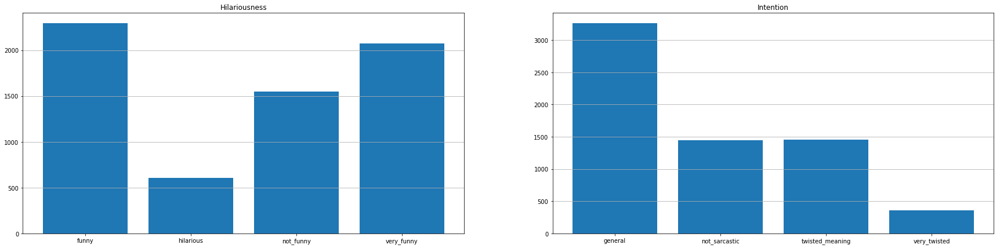

In [44]:
from matplotlib import gridspec

fig = plt.figure(figsize=[30,7])
gs = gridspec.GridSpec(1, 2, width_ratios=[4, 4]) 

plt.subplot(gs[0])
plt.title('Hilariousness')
t = cdata.iloc[:,4]
labels, counts = np.unique(t, return_counts=True)
plt.bar(labels, counts)
plt.grid(axis='y') 

plt.subplot(gs[1])
plt.title('Intention')
t = cdata.iloc[:,5]
labels, counts = np.unique(t, return_counts=True)
plt.bar(labels, counts)
plt.grid(axis='y')

plt.show()

# Converting Hilariousness into Categorical features

In [45]:
# # Label encode
# hilariousness = cdata.iloc[:,4]
# le = preprocessing.LabelEncoder()
# transf = le.fit_transform(hilariousness)
# print("Identified :", le.classes_)

# # Break into different categories
# hilariousness = np.zeros([hilariousness.shape[0],4])

# for idx,types in enumerate(transf):
#     hilariousness[idx][types] = 1
    
# print("Transformed :", le.inverse_transform([0,1,2,3]))

# # Make Dataframe
# cols = ['isFunny', 'isHilarious', 'isNotFunny', 'isVeryFunny']
# hilariousness = pd.DataFrame(hilariousness, columns = cols, dtype=np.int8)
# hilariousness_ordinal = hilariousness
# hilariousness_ordinal

In [46]:
hilariousness = pd.DataFrame(cdata.iloc[:,4])
hilariousness.columns = ['Hilariousness']

hilariousness = hilariousness.replace({'Hilariousness': {
                            'not_funny':0, 
                            'funny':1, 
                            'very_funny':2, 
                            'hilarious':3
                            }})

hilariousness

,Hilariousness
0,3
1,0
2,2
3,2
4,3
...,...
6516,2
6517,1
6518,1
6519,0


# Converting Intentions into Categorical features

In [47]:
# # Label encode
# intentions = cdata.iloc[:,5]
# le = preprocessing.LabelEncoder()
# transf = le.fit_transform(intentions)
# print("Identified :", le.classes_)

# # Break into different categories
# intentions = np.zeros([intentions.shape[0],4])

# for idx,types in enumerate(transf):
#     intentions[idx][types] = 1
    
# print("Transformed :", le.inverse_transform([0,1,2,3]))

# # Make Dataframe
# cols = ['isGeneral', 'isNotSarcastic', 'isTwisted', 'isVeryTwisted']
# intentions = pd.DataFrame(intentions, columns = cols, dtype=np.int8)
# intentions_ordinal = intentions
# intentions_ordinal

In [48]:
intentions = pd.DataFrame(cdata.iloc[:,5])
intentions.columns = ['Intentions']

intentions = intentions.replace({'Intentions': {
                            'general':0, 
                            'not_sarcastic':1, 
                            'twisted_meaning':2, 
                            'very_twisted':3, 
                            }})

intentions

,Intentions
0,0
1,0
2,1
3,2
4,3
...,...
6516,2
6517,2
6518,0
6519,2


# Turning labels into Ordinals

In [49]:
labels = cdata.iloc[:,6:]
labels.columns = ['Offensiveness', 'isMotivational', 'Sentiment']
labels.head()

,Offensiveness,isMotivational,Sentiment
0,not_offensive,not_motivational,very_positive
1,not_offensive,motivational,very_positive
2,not_offensive,not_motivational,positive
3,very_offensive,motivational,positive
4,very_offensive,not_motivational,neutral


In [50]:
labels = labels.replace({'Offensiveness': {
                            'not_offensive':0, 
                            'slight':1, 
                            'very_offensive':2, 
                            'hateful_offensive':3
                            }})

labels = labels.replace({'isMotivational': {
                            'not_motivational':0, 
                            'motivational':1
                            }})

labels = labels.replace({'Sentiment': {
                            'very_negative':0, 
                            'negative':1, 
                            'neutral':2, 
                            'positive':3, 
                            'very_positive':4
                            }})

labels.head()

,Offensiveness,isMotivational,Sentiment
0,0,0,4
1,0,1,4
2,0,0,3
3,2,1,3
4,2,0,2


# Converting templates into Categorical features

In [51]:
template_list = [
    "10_year",
    "avengers",
    "baby",
    "barney",
    "bean",
    "best",
    "bethe",
    "big_bang",
    "cat_U",
    "chandler",
    "chuck",
    "country",
    "deadpool",
    "decaprio",
    "distracted_bf",
    "dr_evil",
    "drunk_baby",
    "feminist",
    "friends",
    "gene",
    "gf",
    "giorgio",
    "godfather",
    "got",
    "harry",
    "harvey",
    "hillary",
    "hitler",
    "jim",
    "joker",
    "kim",
    "liam",
    "lor",
    "minion",
    "misog",
    "modi",
    "morpheous",
    "mrbri",
    "nemo",
    "obama",
    "penguin",
    "pepe",
    "picard",
    "putin",
    "racis",
    "rahul",
    "seal",
    "sexist",
    "skeptical",
    "spector",
    "spiderman",
    "sports",
    "stevejobs",
    "success",
    "tech",
    "third",
    "titanic",
    "tom",
    "trump",
    "x_men",
    "zeck",
]

In [52]:
file_names = cdata.iloc[:, 0]
file_templates_list = []

for file_name in file_names:
    file_templates = np.zeros([1,len(template_list)])
    
    for i,template in enumerate(template_list):
        if(file_name.find(template) != -1):            
            file_templates[0,i] = 1
#             print(template)
#     print(file_name)
#     print('------------------------------------------------------------------------------------------')

    file_templates_list.append(file_templates)

In [53]:
file_templates_list = np.asarray(file_templates_list).squeeze()
templates_df = pd.DataFrame(file_templates_list, columns=['template_'+template for template in template_list], dtype=np.int8)
templates_df

,template_10_year,template_avengers,template_baby,template_barney,template_bean,template_best,template_bethe,template_big_bang,template_cat_U,template_chandler,...,template_sports,template_stevejobs,template_success,template_tech,template_third,template_titanic,template_tom,template_trump,template_x_men,template_zeck
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6516,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6517,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6518,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6519,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


# Cleaning Text

In [ ]:
import nltk
import spacy
import string
import re
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

from nltk.corpus import stopwords 
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer 
from nltk.tokenize import word_tokenize 

In [55]:
### DEFAULT word preprocessing funcitons

# Turn to lowercase
def text_lowercase(text): 
    return text.lower() 

# Remove numbers 
def remove_numbers(text): 
    result = re.sub(r'\d+', '', text) 
    return result 

# Remove punctuation 
# TODO : Add space to prevent concat
def remove_punctuation(word_array):
    output_word_array = []
    
    for word in word_array:
        translator = str.maketrans('', '', string.punctuation) 
        clean_word = word.translate(translator)
        if(clean_word != ''): output_word_array.append(clean_word)
    
    return output_word_array

# Remove stopwords function 
def remove_stopwords(text): 
    stop_words = set(stopwords.words("english")) 
    word_tokens = word_tokenize(text) 
    filtered_text = [word for word in word_tokens if word not in stop_words] 
    return filtered_text 

# Lemmatize string 
lemmatizer = WordNetLemmatizer() 
def lemmatize_word(word_array):
    lemmatized_word_array = []
    for word in word_array:
        word_tokens = word_tokenize(word) 
        lemmas = [lemmatizer.lemmatize(word, pos ='v') for word in word_tokens] 
        lemmatized_word_array += lemmas
    
    return lemmatized_word_array 
  
print(text_lowercase("Hey, did you know that the summer break is coming? Amazing right !! It's only 5 more days !!"))
print(remove_numbers("There are 3 balls in this bag, and 12 in the other one.")  )
print(remove_punctuation("Hey, did you know that the #summer_break is... coming? Amazing @right !! It's only 5 more days !!".split()))
print(remove_stopwords("This is a sample sentence and we are going to remove the stopwords from this.")) 
print(lemmatize_word('Data science uses scientific methods algorithms and many types of processes'.split())) 

hey, did you know that the summer break is coming? amazing right !! it's only 5 more days !!
There are  balls in this bag, and  in the other one.
['Hey', 'did', 'you', 'know', 'that', 'the', 'summerbreak', 'is', 'coming', 'Amazing', 'right', 'Its', 'only', '5', 'more', 'days']
['This', 'sample', 'sentence', 'going', 'remove', 'stopwords', '.']
['Data', 'science', 'use', 'scientific', 'methods', 'algorithms', 'and', 'many', 'type', 'of', 'process']


In [56]:
### CUSTOM word preprocessing functions
### Domain specific

# Handle website names.
# Remove only the words containg '.com', '.co', '.net' ?
# Remove all words containg '.' except when dot is last character.
# Do befoer removing puncttuation.
def remove_word_containing_dot(text_arr):
    clean_text_arr = []
    
    for word in text_arr:
        if(word.find('.') == -1 or word.find('.') == len(word)-1):
            clean_text_arr.append(word)
    
    return clean_text_arr

# Handle twitter stuff.
# Remove connon words.
# Remove month names.
def remove_twitter(text_arr):
    banned_words = ["retweets", "likes", "k", "pm", "follow"]
    months = ["jan", "feb", "mar", "apr", "may", "jun", "jul", "aug", "sep", "oct", "nov", "dec"]
    
    conc_remove_words = banned_words + months
    # print(conc_remove_words)
    
    clean_text_arr = []
        
    for word in text_arr:
        if(word not in conc_remove_words):
            clean_text_arr.append(word)
    
    return clean_text_arr
# Handle twitter timestamp
# Remove all words after the first word containg ':'
# Bad idea see meme at idx:6.
# SKIPPED for now
def remove_all_text_after_colon(text):
    return text

print(remove_word_containing_dot("Me a memee text. SnoopyMems.com. Here more meme text. AnotherWebsite.net".split()))
print(remove_twitter("Kudus to @narendramodi ji 8:05 PM - 16 Jan 2019 from Mumbai, India".split()))

['Me', 'a', 'memee', 'text.', 'Here', 'more', 'meme', 'text.']
['Kudus', 'to', '@narendramodi', 'ji', '8:05', 'PM', '-', '16', 'Jan', '2019', 'from', 'Mumbai,', 'India']


In [57]:
# TODO : Dont remove 2009, 2019 as they actually contain meme context while removing numbers.


def clean_text(input_text):

    string = text_lowercase(input_text)
    string = remove_numbers(string)
    text_arr = string.split()
    
    text_arr = remove_word_containing_dot(text_arr)
    text_arr = remove_punctuation(text_arr)
    text_arr = remove_twitter(text_arr)
#     arr = remove_stopwords(string)
    
    text_arr = lemmatize_word(text_arr)
    return text_arr

print(clean_text("Hey, did you know that 4 the summer Break is coming? Amazing right !! It's only 5 more days !!"))
print(clean_text("Me a memee text. SnoopyMems.com. Here more meme text. AnotherWebsite.net"))
print(clean_text("Kudus to @narendramodi ji 8:05 PM - 16 Jan 2019 from Mumbai, India"))
print(clean_text("Sam Thorne @Strippin ( Follow Follow Saw everyone posting these 2009 vs 2019 pics so here's mine 6:23 PM - 12 Jan 2019 O 636 Retweets 3 224 LIKES 65 636 3.2K "))

['hey', 'do', 'you', 'know', 'that', 'the', 'summer', 'break', 'be', 'come', 'amaze', 'right', 'its', 'only', 'more', 'days']
['me', 'a', 'memee', 'text', 'here', 'more', 'meme', 'text']
['kudus', 'to', 'narendramodi', 'ji', 'from', 'mumbai', 'india']
['sam', 'thorne', 'strippin', 'saw', 'everyone', 'post', 'these', 'vs', 'pics', 'so', 'heres', 'mine', 'o']


# 0
LOOK THERE MY FRIEND LIGHTYEAR NOW ALL SOHALIKUT TREND PLAY THE 10 YEARS CHALLENGE AT FACEBOOK imgflip.com 
['look', 'there', 'my', 'friend', 'lightyear', 'now', 'all', 'sohalikut', 'trend', 'play', 'the', 'years', 'challenge', 'at', 'facebook']


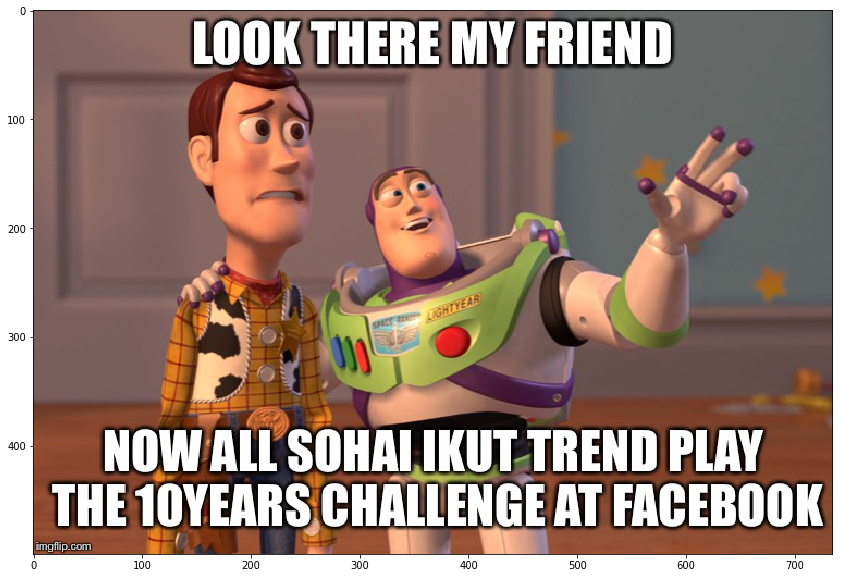

-------------------------------------------------------------------------
# 1
The best of #10 YearChallenge! Completed in less the 4 years. Kudus to @narendramodi ji 8:05 PM - 16 Jan 2019 from Mumbai  India 
['the', 'best', 'of', 'yearchallenge', 'complete', 'in', 'less', 'the', 'years', 'kudus', 'to', 'narendramodi', 'ji', 'from', 'mumbai', 'india']


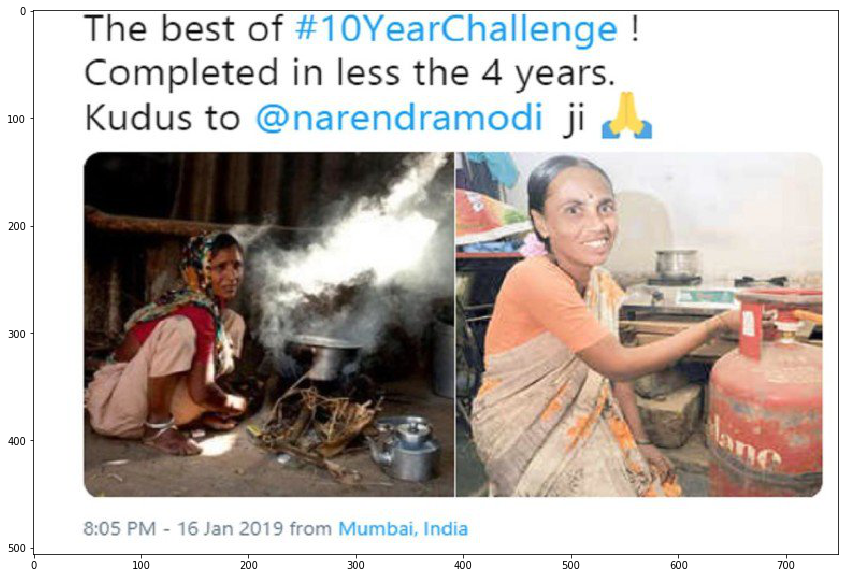

-------------------------------------------------------------------------
# 2
Sam Thorne @Strippin ( Follow Follow Saw everyone posting these 2009 vs 2019 pics so here's mine 6:23 PM - 12 Jan 2019 O 636 Retweets 3 224 LIKES 65 636 3.2K 
['sam', 'thorne', 'strippin', 'saw', 'everyone', 'post', 'these', 'vs', 'pics', 'so', 'heres', 'mine', 'o']


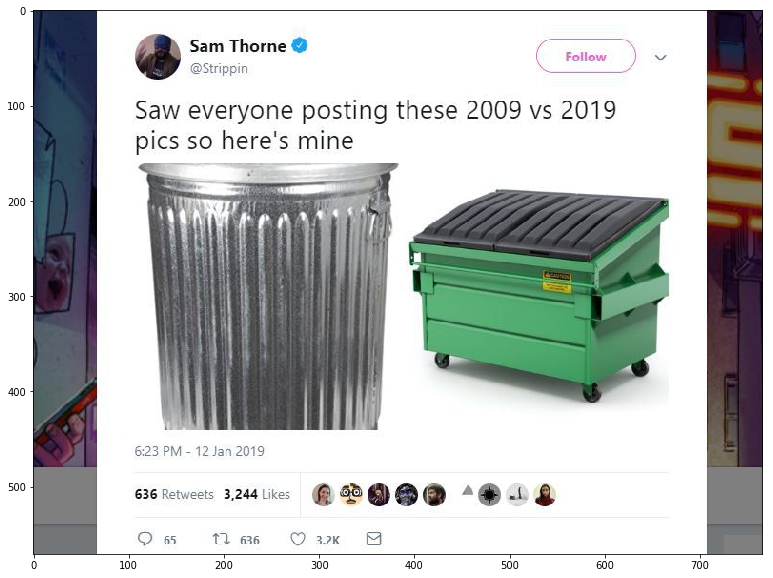

-------------------------------------------------------------------------
# 3
10 Year Challenge - Sweet Dee Edition 
['year', 'challenge', 'sweet', 'dee', 'edition']


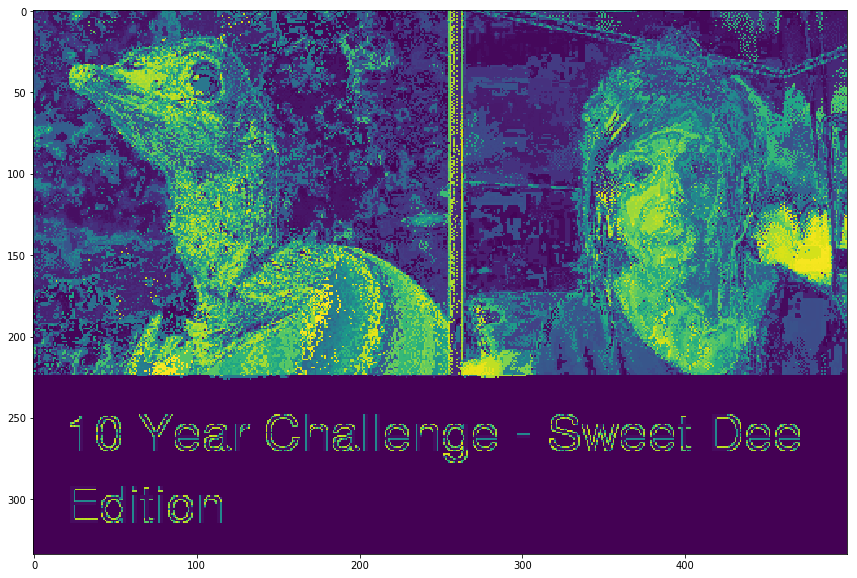

-------------------------------------------------------------------------
# 4
10 YEAR CHALLENGE WITH NO FILTER 47 Hilarious 10 Year Challenge Memes | What is #10 Year Challenge? 
['year', 'challenge', 'with', 'no', 'filter', 'hilarious', 'year', 'challenge', 'memes', 'what', 'be', 'year', 'challenge']


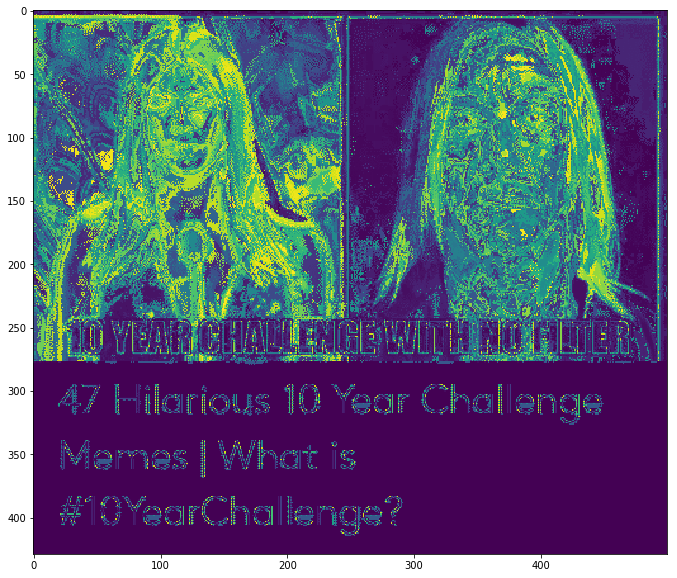

-------------------------------------------------------------------------
# 5
1998: "Don't get in car with strangers" 2008: "Don't meet people from the internet alone." MemeCenter.com 2019: UBER.. Order yourself a stranger from the internet to get into a car with alone. 
['dont', 'get', 'in', 'car', 'with', 'strangers', 'dont', 'meet', 'people', 'from', 'the', 'internet', 'order', 'yourself', 'a', 'stranger', 'from', 'the', 'internet', 'to', 'get', 'into', 'a', 'car', 'with', 'alone']


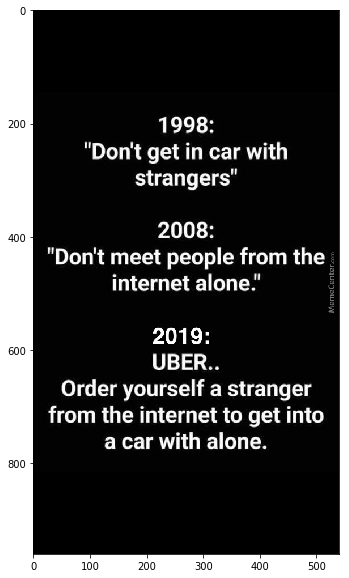

-------------------------------------------------------------------------
# 6
10 years challenge is lit af Üs & B erg 1945 1955 Wow such transformation! 
['years', 'challenge', 'be', 'light', 'af', 'üs', 'b', 'erg', 'wow', 'such', 'transformation']


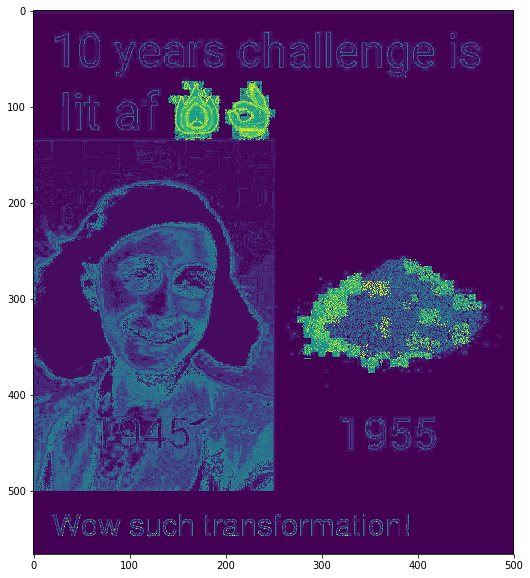

-------------------------------------------------------------------------
# 7
10 Year Challenge emotional edition boredpanda.com 
['year', 'challenge', 'emotional', 'edition']


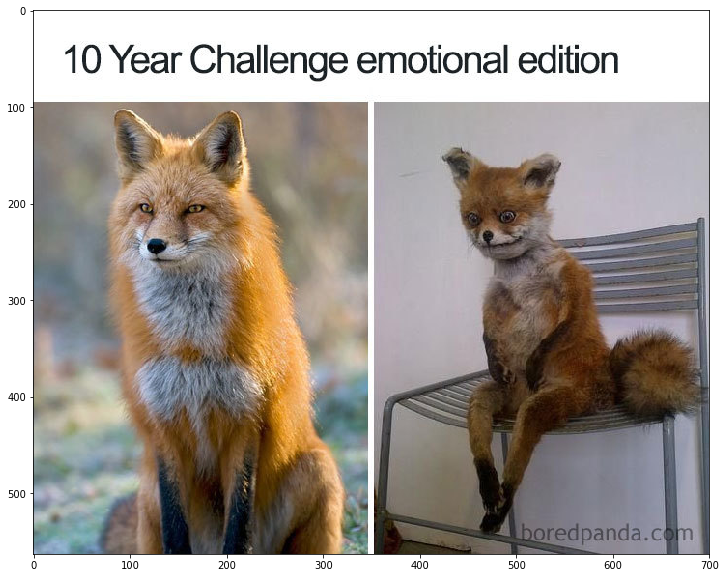

-------------------------------------------------------------------------
# 8
Fornite died in 10 months but Minecraft never died in 10 years I am so proud of this community 
['fornite', 'die', 'in', 'months', 'but', 'minecraft', 'never', 'die', 'in', 'years', 'i', 'be', 'so', 'proud', 'of', 'this', 'community']


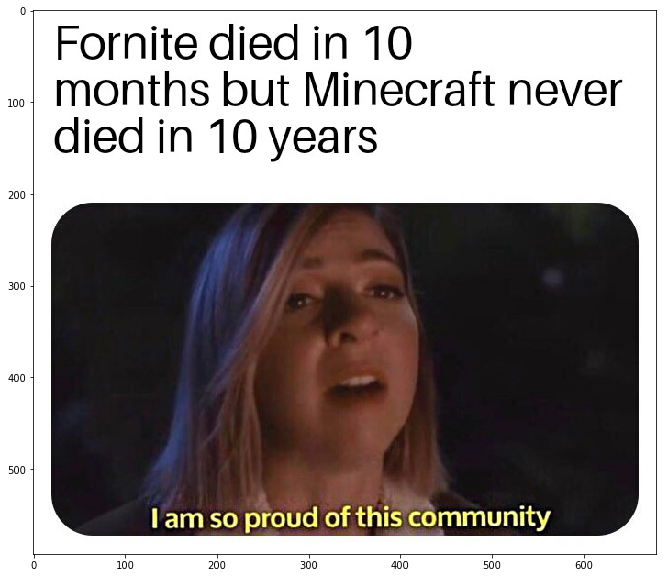

-------------------------------------------------------------------------
# 9
FACEBOOK '10 YEAR CHALLENGE': A PLOY OR A SIMPLE MEME? mo by eXo Hạ Minh Le 18 Jan 2018 
['facebook', 'year', 'challenge', 'a', 'ploy', 'or', 'a', 'simple', 'meme', 'mo', 'by', 'exo', 'hạ', 'minh', 'le']


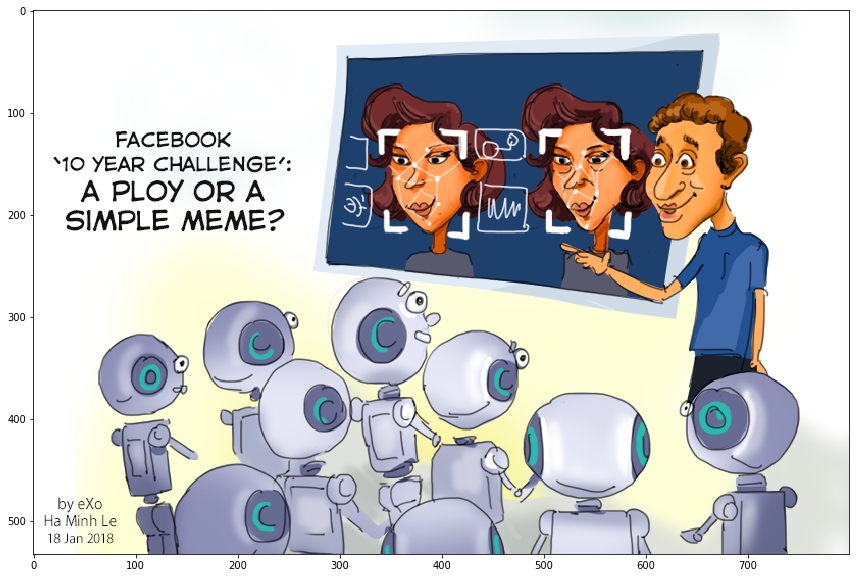

-------------------------------------------------------------------------
# 10
PROBABLY THE FIRST MAN TO DO 10 YEAR CHALLENGE Chennai pasanga da 
['probably', 'the', 'first', 'man', 'to', 'do', 'year', 'challenge', 'chennai', 'pasanga', 'da']


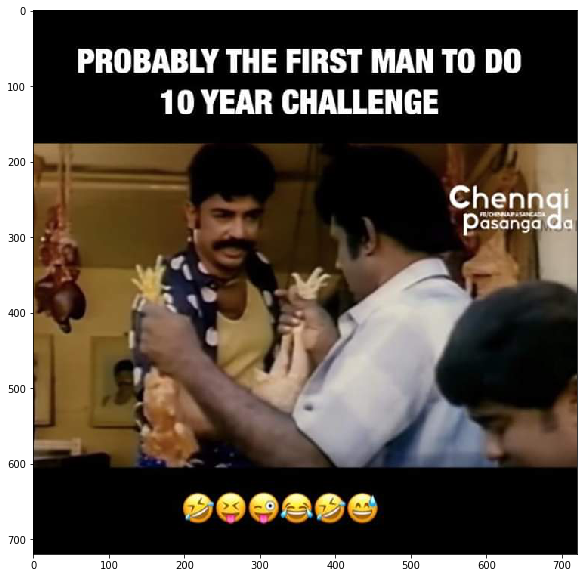

-------------------------------------------------------------------------
# 11
State Dining Room in the White House: 2009 vs. 2019 boredpanda.com 
['state', 'din', 'room', 'in', 'the', 'white', 'house', 'vs']


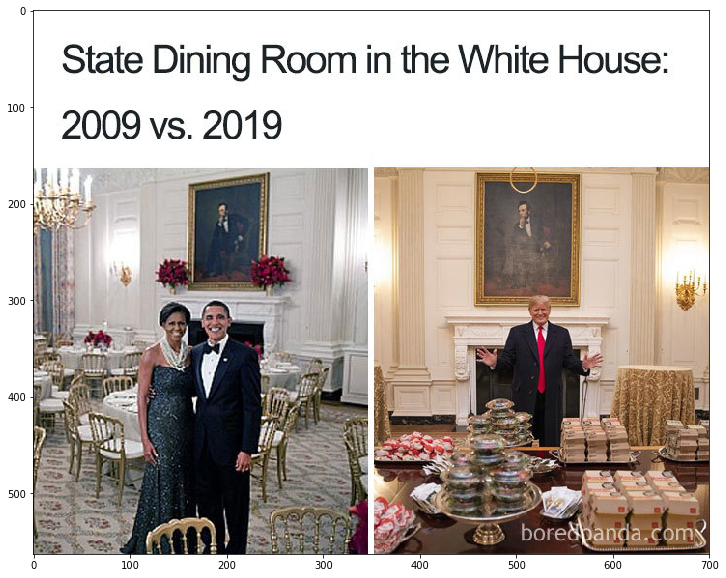

-------------------------------------------------------------------------
# 12
I did the Facebook 10 year challenge and it was not kind to me. I went 10 years into the future instead of back. Instant regrets. 
['i', 'do', 'the', 'facebook', 'year', 'challenge', 'and', 'it', 'be', 'not', 'kind', 'to', 'me', 'i', 'go', 'years', 'into', 'the', 'future', 'instead', 'of', 'back', 'instant', 'regret']


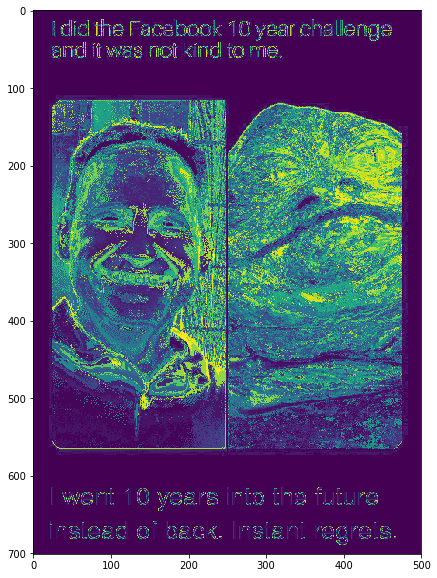

-------------------------------------------------------------------------
# 13
IFIDOWNLOADA MOVIE IN JAMAICA Memes in 2009 AMI A PIRATE OF THE CARIBBEAN? me: *picks up food from the floor in 4.99 sec* bacteria: Memes in 2019 *ANGRY AS FUCK* 
['ifidownloada', 'movie', 'in', 'jamaica', 'memes', 'in', 'ami', 'a', 'pirate', 'of', 'the', 'caribbean', 'me', 'pick', 'up', 'food', 'from', 'the', 'floor', 'in', 'sec', 'bacteria', 'memes', 'in', 'angry', 'as', 'fuck']


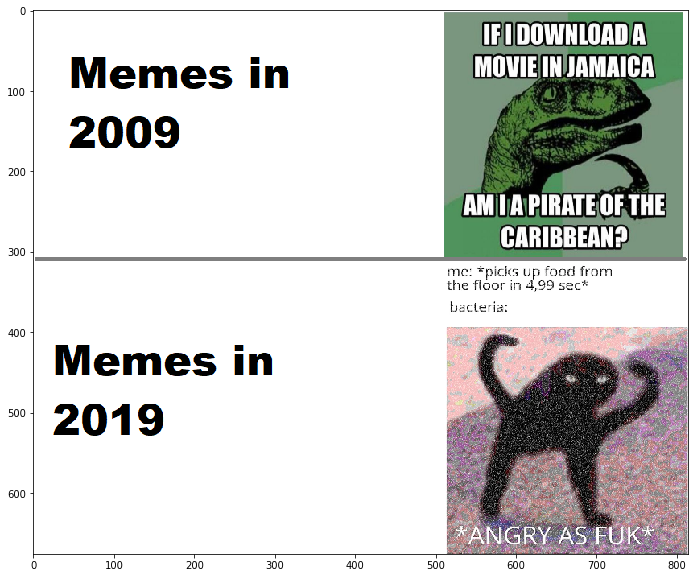

-------------------------------------------------------------------------
# 14
Anti-vaxx kids when they see someone doing the 10 year challenge 
['antivaxx', 'kid', 'when', 'they', 'see', 'someone', 'do', 'the', 'year', 'challenge']


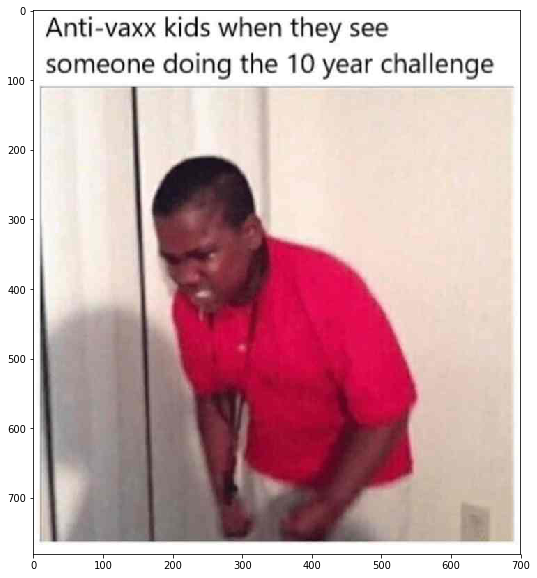

-------------------------------------------------------------------------
# 15
I don't get this 10 year challenge  time is not something I acknowledge. 
['i', 'dont', 'get', 'this', 'year', 'challenge', 'time', 'be', 'not', 'something', 'i', 'acknowledge']


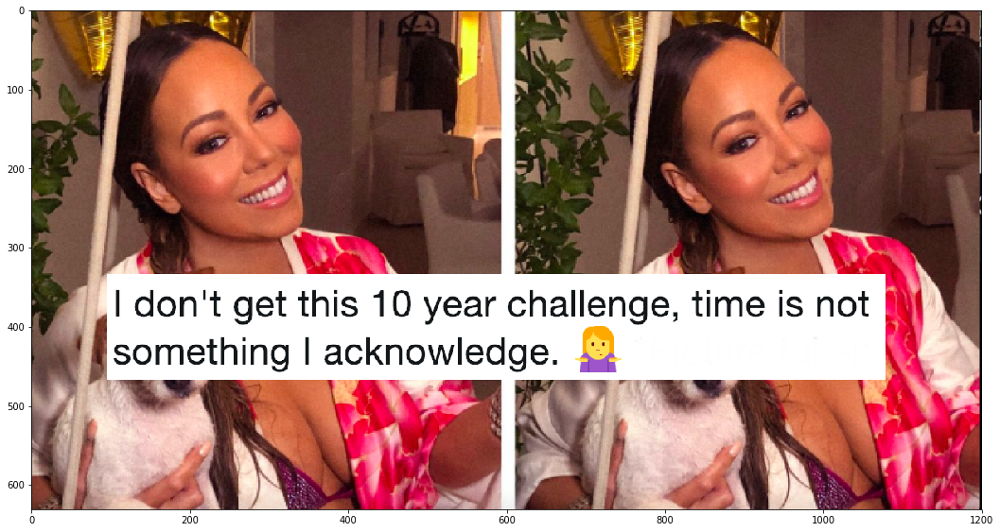

-------------------------------------------------------------------------
# 16
When you wakeup and read the messages you sent to actual family members instead of just friends while drunk 
['when', 'you', 'wakeup', 'and', 'read', 'the', 'message', 'you', 'send', 'to', 'actual', 'family', 'members', 'instead', 'of', 'just', 'friends', 'while', 'drink']


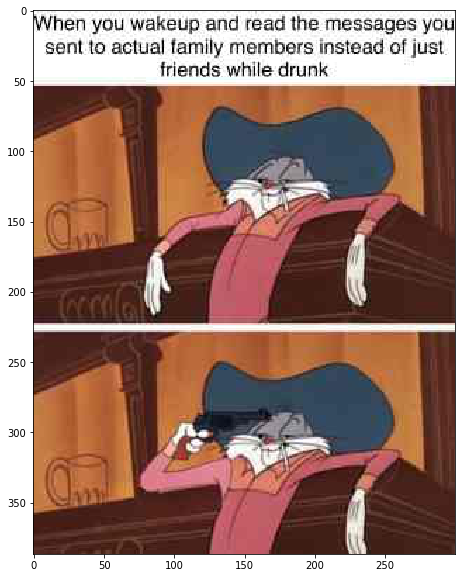

-------------------------------------------------------------------------
# 17
When you're looking through the latest memes and realize you just lost the game I have decided that I want to die. 
['when', 'youre', 'look', 'through', 'the', 'latest', 'memes', 'and', 'realize', 'you', 'just', 'lose', 'the', 'game', 'i', 'have', 'decide', 'that', 'i', 'want', 'to', 'die']


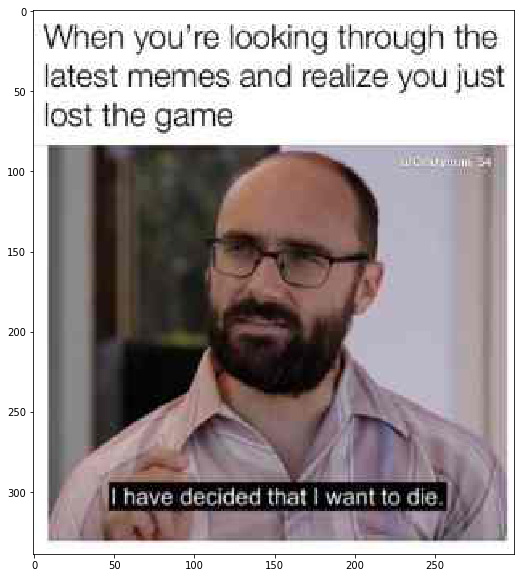

-------------------------------------------------------------------------
# 18
Why do 10 years challenge when you can do 20 years 1999 2019 
['why', 'do', 'years', 'challenge', 'when', 'you', 'can', 'do', 'years']


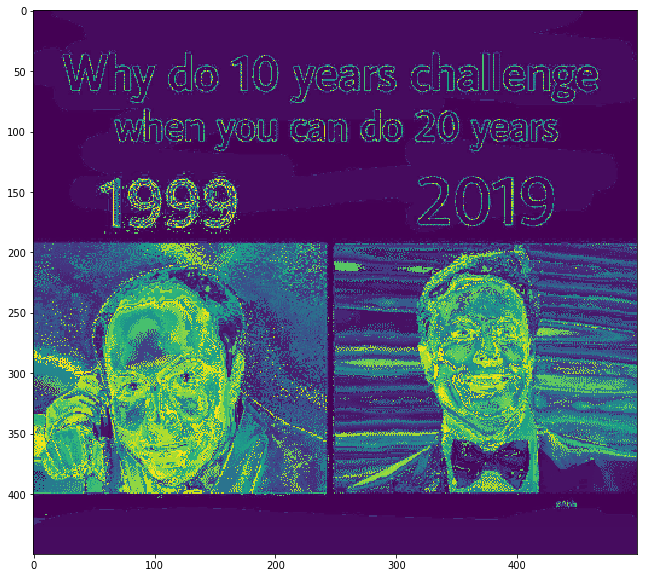

-------------------------------------------------------------------------
# 19
NO SPOILERS FOR AVENGERS INFINITY WAR! THANOS DEMANDS YOUR SILENCE IG dushrox16 
['no', 'spoilers', 'for', 'avengers', 'infinity', 'war', 'thanos', 'demand', 'your', 'silence', 'ig', 'dushrox']


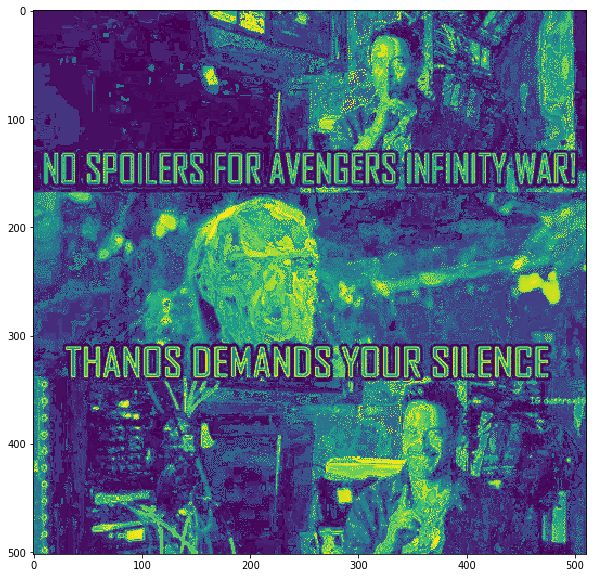

-------------------------------------------------------------------------
# 20
REMEMBER THIS KID? THIS IS HIM NOW FEEL OLD YET? 
['remember', 'this', 'kid', 'this', 'be', 'him', 'now', 'feel', 'old', 'yet']


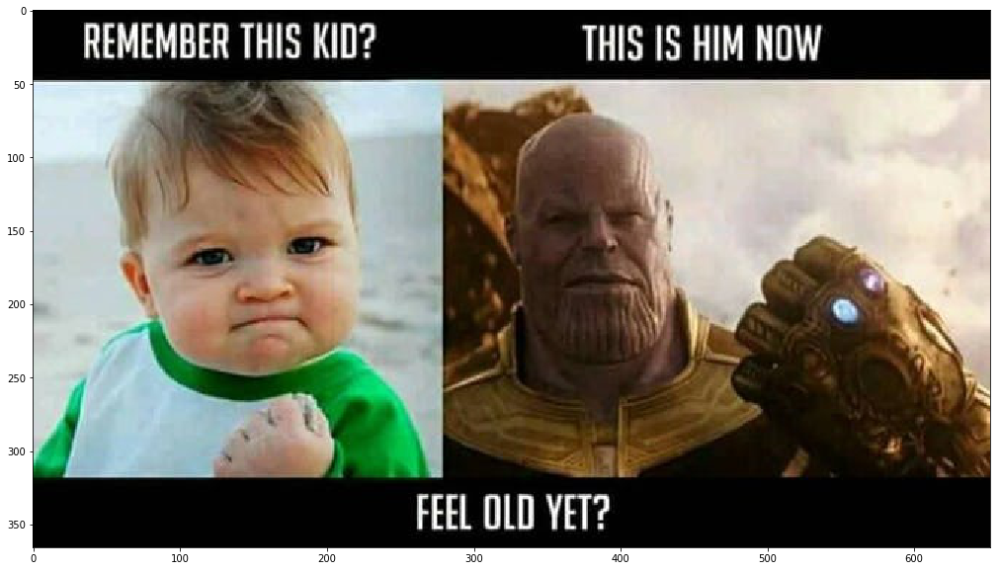

-------------------------------------------------------------------------
# 21
WE HAVE A HULK WE HAVE THE RIGHTS TO ALL OUR CHARACTERS 
['we', 'have', 'a', 'hulk', 'we', 'have', 'the', 'right', 'to', 'all', 'our', 'character']


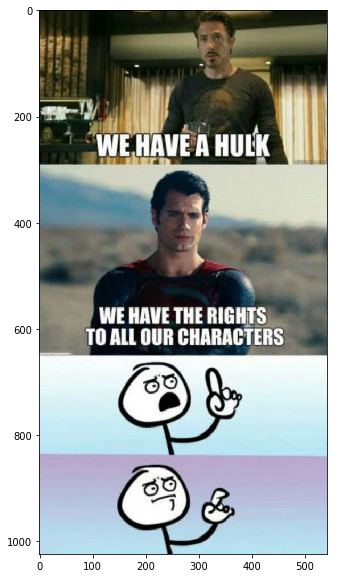

-------------------------------------------------------------------------
# 22
IS THERE AN ALL-FEMALE AVENGERS MOVIE IN THE WORKS? A FORCE Sounds great! But who would they fight? Each other  probably 
['be', 'there', 'an', 'allfemale', 'avengers', 'movie', 'in', 'the', 'work', 'a', 'force', 'sound', 'great', 'but', 'who', 'would', 'they', 'fight', 'each', 'other', 'probably']


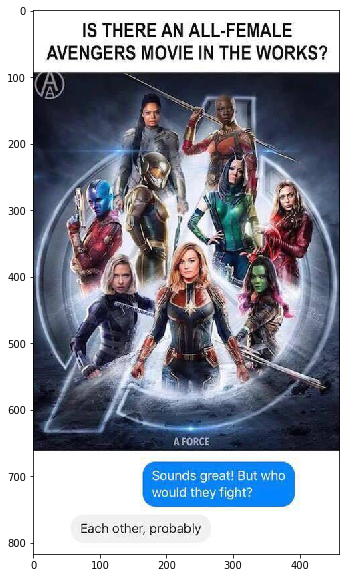

-------------------------------------------------------------------------
# 23
I have an army. We have a Hulk. I've gotta jar of dirt! more awesome pictures at THEMETAPICTURE.COM 
['i', 'have', 'an', 'army', 'we', 'have', 'a', 'hulk', 'ive', 'get', 'ta', 'jar', 'of', 'dirt', 'more', 'awesome', 'picture', 'at']


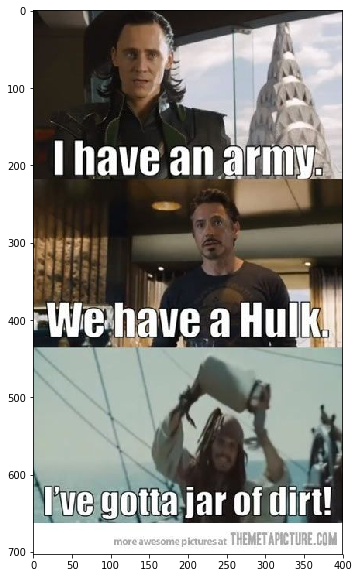

-------------------------------------------------------------------------
# 24
LANGUAGE! (..REALLY? IG BLERD.VISION ...DID WE JUST BECOME BEST FRIENDS?! ...LATER 
['language', 'ig', 'we', 'just', 'become', 'best', 'friends']


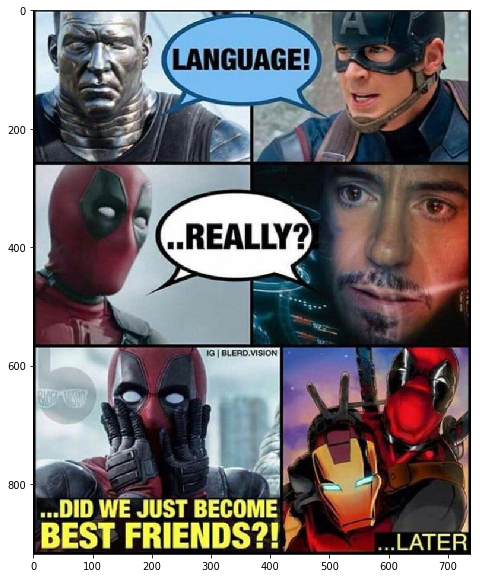

-------------------------------------------------------------------------
# 25
Sucks that the Thanos snap also claimed Captain's Beard 
['suck', 'that', 'the', 'thanos', 'snap', 'also', 'claim', 'captain', 'beard']


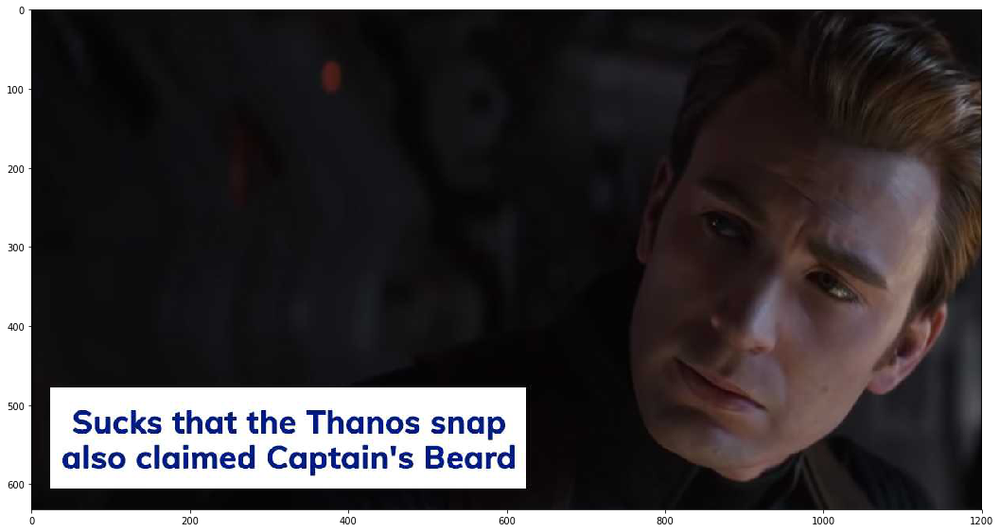

-------------------------------------------------------------------------
# 26
I wonder why Who's that!? ..they call him Hawkeye Lord goku and vegeta!!?? 
['i', 'wonder', 'why', 'whos', 'that', 'call', 'him', 'hawkeye', 'lord', 'goku', 'and', 'vegeta']


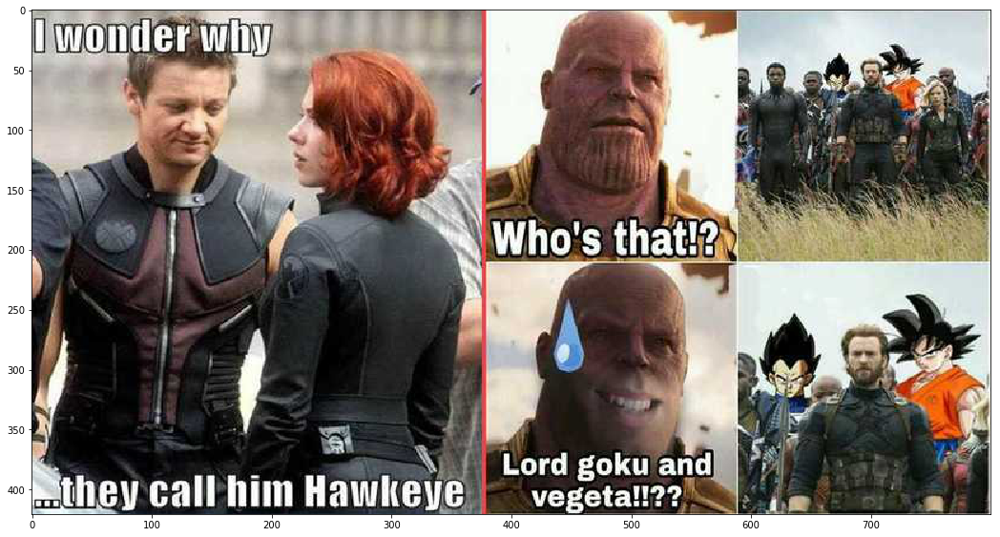

-------------------------------------------------------------------------
# 27
EVERY TIME I ALREADY KNOW A VERSE "I UNDERSTOOD THAT REFERENCE" Memes:Hilarious Avengers Memes  Dank Memes of Avengers and Funny Dank Memes 
['every', 'time', 'i', 'already', 'know', 'a', 'verse', 'i', 'understand', 'that', 'reference', 'memeshilarious', 'avengers', 'memes', 'dank', 'memes', 'of', 'avengers', 'and', 'funny', 'dank', 'memes']


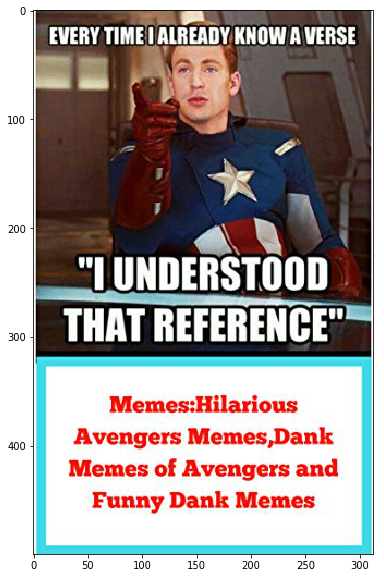

-------------------------------------------------------------------------
# 28
HEY PETER WHAT'S NEW? WELL I GET TO WORK WITH THE AVENGERS IN THE NEW MOVIE! OH GOOD FOR YOU  UNDEROOS imgflip.com 
['hey', 'peter', 'whats', 'new', 'well', 'i', 'get', 'to', 'work', 'with', 'the', 'avengers', 'in', 'the', 'new', 'movie', 'oh', 'good', 'for', 'you', 'underoos']


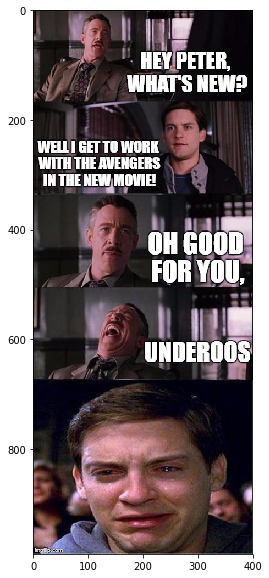

-------------------------------------------------------------------------
# 29
Wants Spider-Man in next "Avengers" movie SONY memecreator.com 
['want', 'spiderman', 'in', 'next', 'avengers', 'movie', 'sony']


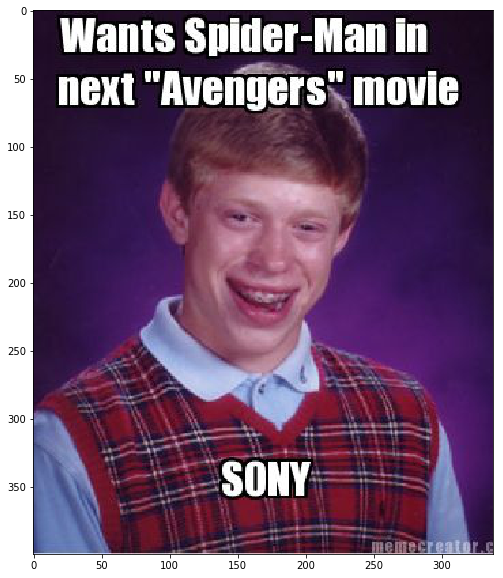

-------------------------------------------------------------------------
# 30
OH THERE'S A NEW AVENGERS MOVIE? TELL ME AGAIN HOW MUCH YOU ARE GOING TO AVOID SPOILERS 
['oh', 'theres', 'a', 'new', 'avengers', 'movie', 'tell', 'me', 'again', 'how', 'much', 'you', 'be', 'go', 'to', 'avoid', 'spoilers']


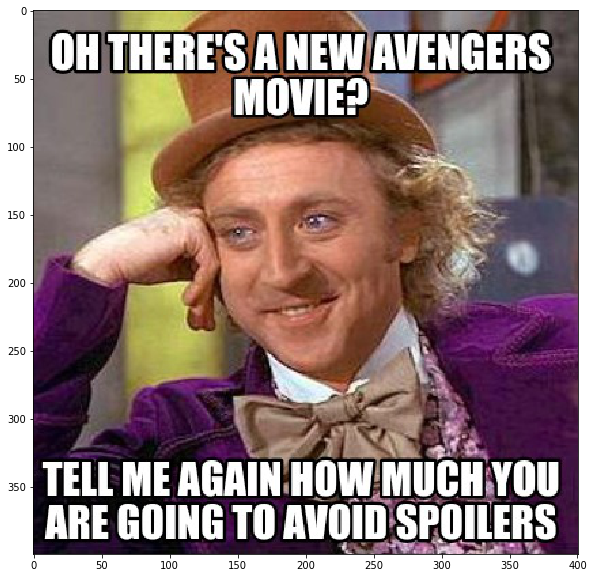

-------------------------------------------------------------------------
# 31
IN AVENGERS: COULSON DIES IN THOR 2: LOKI DIES BUT NOT REALLY BUT NOT REALLY 10BLERD VISION IN CAP 2: FURY DIES IN CIVIL WAR: RHODEY DIES BUT NOT REALLY BUT NOT REALLY GROH. NEVERMIND. AND IN AGE OF ULTRON: QUICKSILVER...) ifunny.co 
['in', 'avengers', 'coulson', 'die', 'in', 'thor', 'loki', 'die', 'but', 'not', 'really', 'but', 'not', 'really', 'blerd', 'vision', 'in', 'cap', 'fury', 'die', 'in', 'civil', 'war', 'rhodey', 'die', 'but', 'not', 'really', 'but', 'not', 'really', 'groh', 'nevermind', 'and', 'in', 'age', 'of', 'ultron']


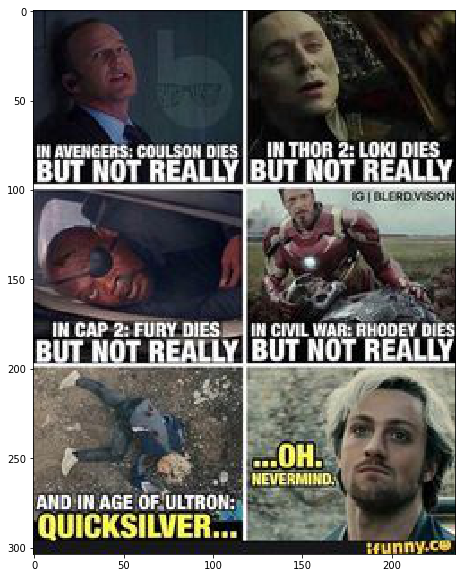

-------------------------------------------------------------------------
# 32
After Avengers End Game 
['after', 'avengers', 'end', 'game']


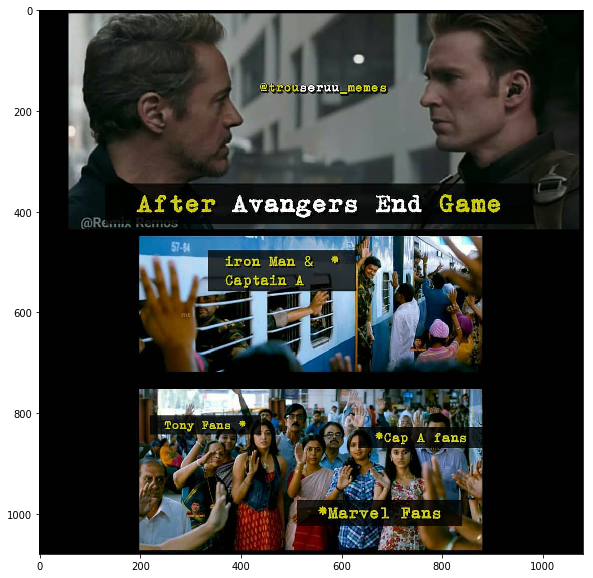

-------------------------------------------------------------------------
# 33
AVENGERS MOVIE STILL NOT WATCHED memegenerator.net 
['avengers', 'movie', 'still', 'not', 'watch']


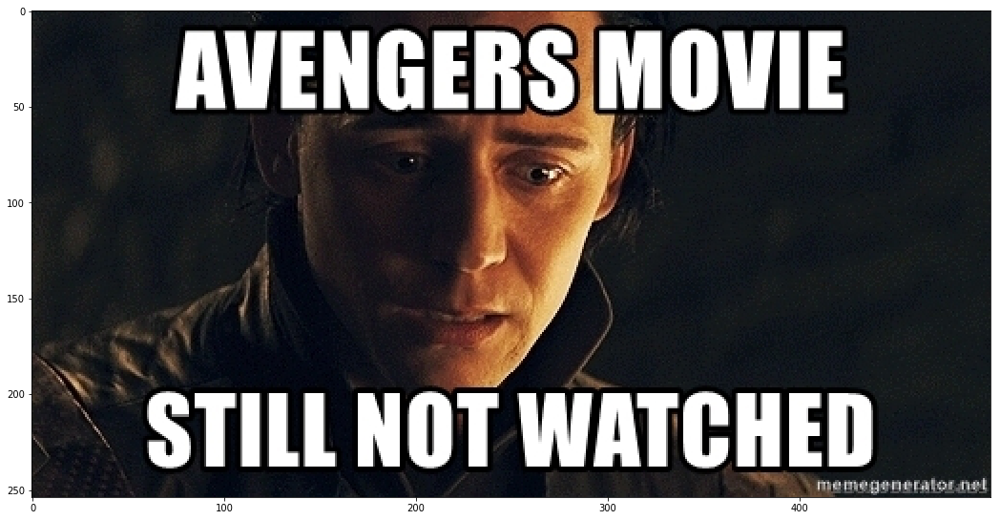

-------------------------------------------------------------------------
# 34
CAN'T WAIT TO SEE CAPTAIN MARVEL ON SCREEN FOR THE FIRST TIME AND ABOVE HIM IS SOME LADY CALLED CAROL DANVERS. 
['cant', 'wait', 'to', 'see', 'captain', 'marvel', 'on', 'screen', 'for', 'the', 'first', 'time', 'and', 'above', 'him', 'be', 'some', 'lady', 'call', 'carol', 'danvers']


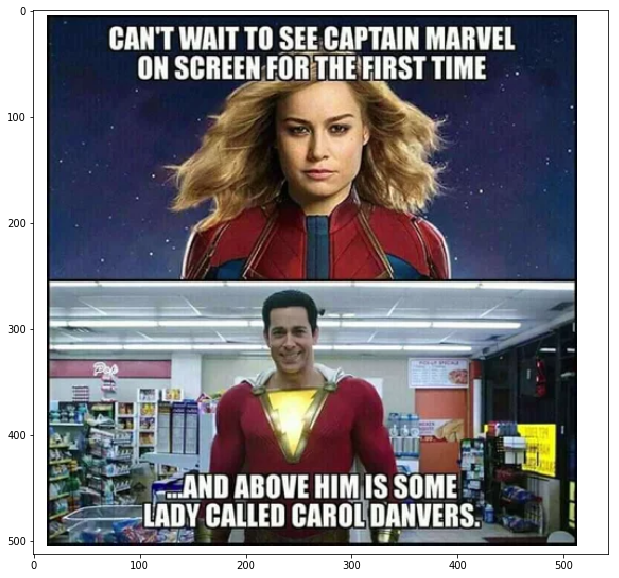

-------------------------------------------------------------------------
# 35
We are in the endgame now. AH! HE SAID IT. HE SAID THE NAME OF THE MOVIE! 
['we', 'be', 'in', 'the', 'endgame', 'now', 'ah', 'he', 'say', 'it', 'he', 'say', 'the', 'name', 'of', 'the', 'movie']


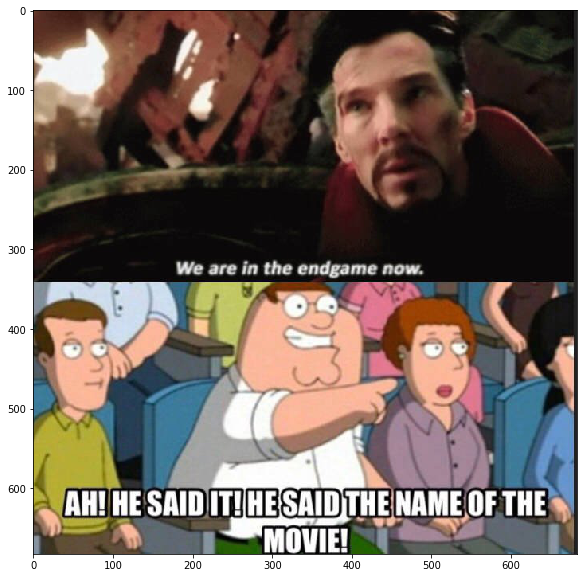

-------------------------------------------------------------------------
# 36
No plot info No action Only like 5 characters appear Big surprise title reveal is the same one fans have been guessing for months Know literally the same amount about the movie as I did before the trailer 
['no', 'plot', 'info', 'no', 'action', 'only', 'like', 'character', 'appear', 'big', 'surprise', 'title', 'reveal', 'be', 'the', 'same', 'one', 'fan', 'have', 'be', 'guess', 'for', 'months', 'know', 'literally', 'the', 'same', 'amount', 'about', 'the', 'movie', 'as', 'i', 'do', 'before', 'the', 'trailer']


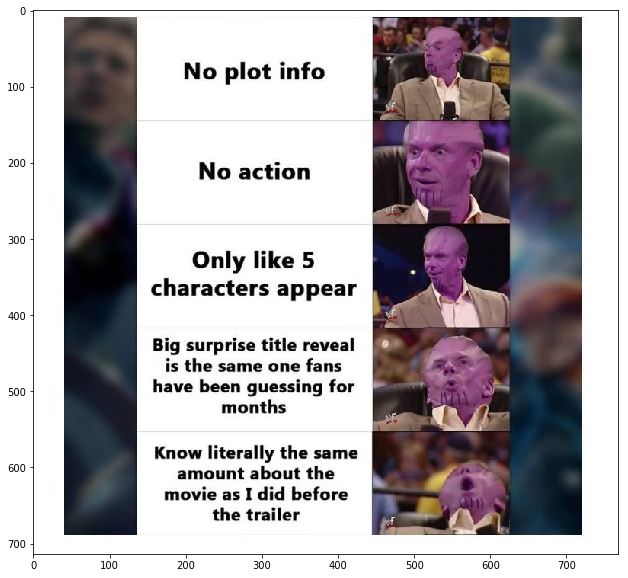

-------------------------------------------------------------------------
# 37
Tell Thanos I'm coming AVENGERS 4 LEAKED SCENE 
['tell', 'thanos', 'im', 'come', 'avengers', 'leak', 'scene']


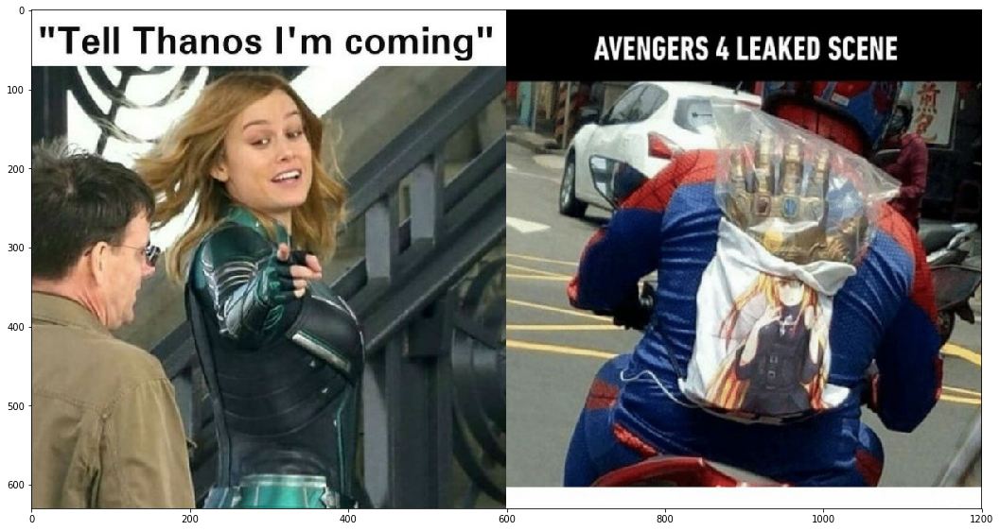

-------------------------------------------------------------------------
# 38
Who you thought was gonna to save the universe who is really going to do it 
['who', 'you', 'think', 'be', 'gon', 'na', 'to', 'save', 'the', 'universe', 'who', 'be', 'really', 'go', 'to', 'do', 'it']


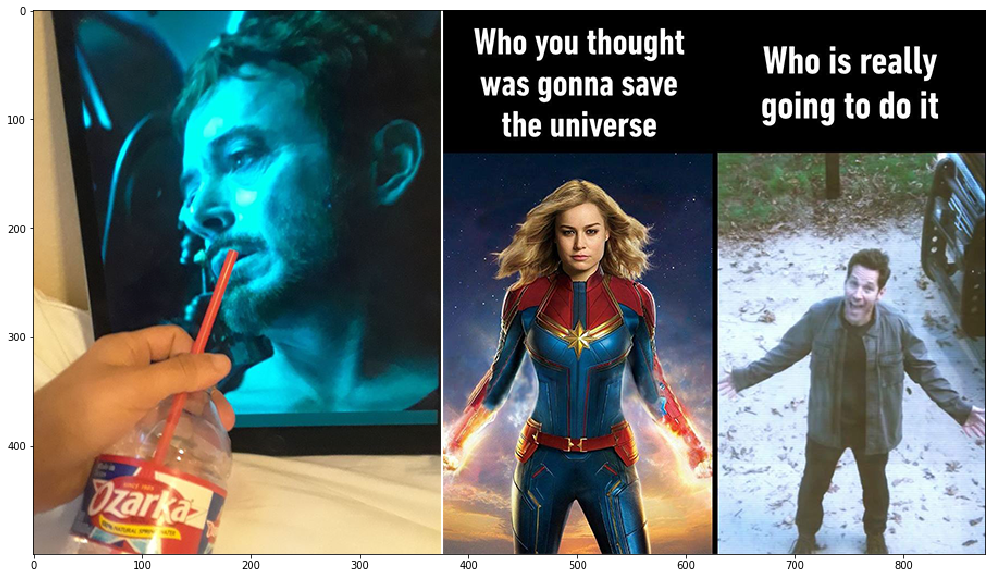

-------------------------------------------------------------------------
# 39
WHEN YOU JUST WATCHED ENDGAME AND HAVE ALL THE SPOILERS. You're not the only one cursed with knowledge 
['when', 'you', 'just', 'watch', 'endgame', 'and', 'have', 'all', 'the', 'spoilers', 'youre', 'not', 'the', 'only', 'one', 'curse', 'with', 'knowledge']


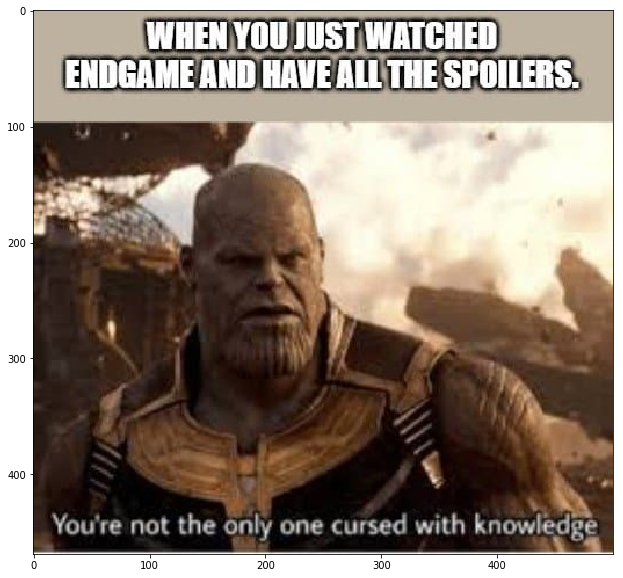

-------------------------------------------------------------------------
# 40
Me: Has seen every Marvel movie before Endgame: 
['me', 'have', 'see', 'every', 'marvel', 'movie', 'before', 'endgame']


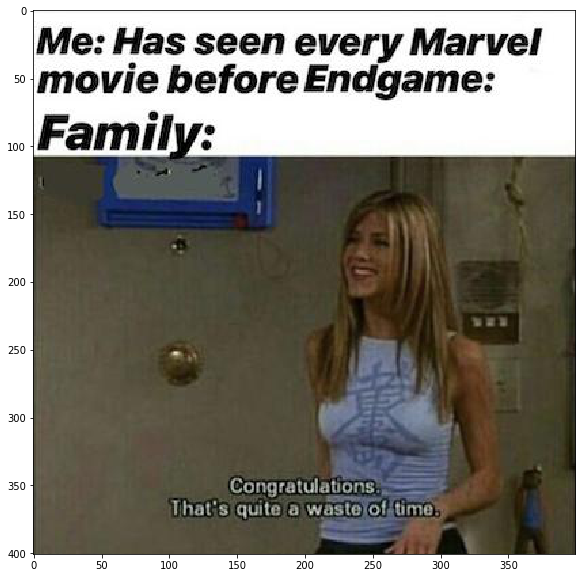

-------------------------------------------------------------------------
# 41
Vaibhav... @lamevaibhav When someone from Facebook joins Twitter and starts Liking all the Tweets "We don't do that here"  
['lamevaibhav', 'when', 'someone', 'from', 'facebook', 'join', 'twitter', 'and', 'start', 'like', 'all', 'the', 'tweet', 'we', 'dont', 'do', 'that', 'here']


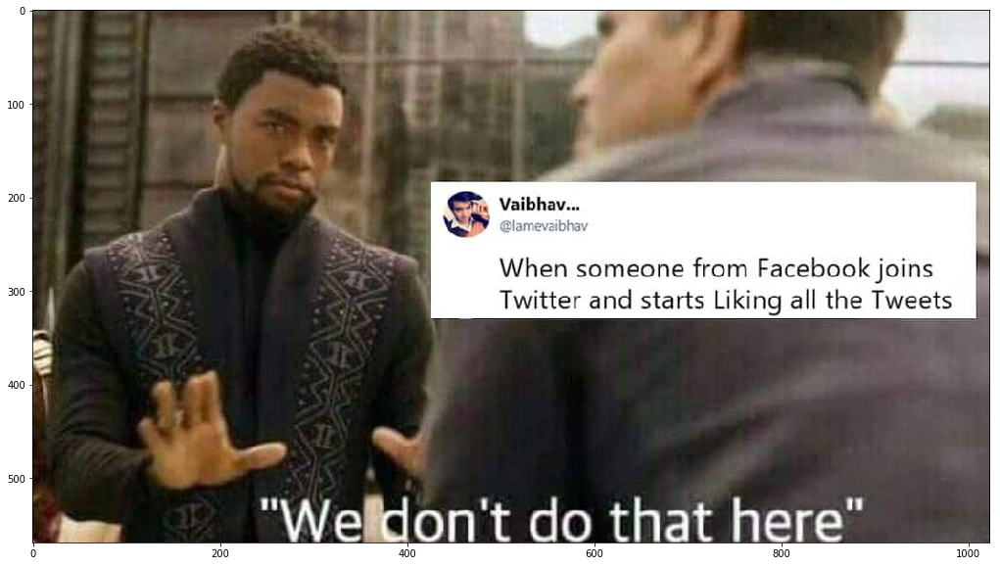

-------------------------------------------------------------------------
# 42
I THINK WE SHOULD JUST KEEP THIS PARTY LOW-KEY GUESS I'M GONNA BE THOR IN THE MORNIN' SEEMS OUR DIFFERENCES ARE PRETTY STARK_ ROGER THAT 
['i', 'think', 'we', 'should', 'just', 'keep', 'this', 'party', 'lowkey', 'guess', 'im', 'gon', 'na', 'be', 'thor', 'in', 'the', 'mornin', 'seem', 'our', 'differences', 'be', 'pretty', 'stark', 'roger', 'that']


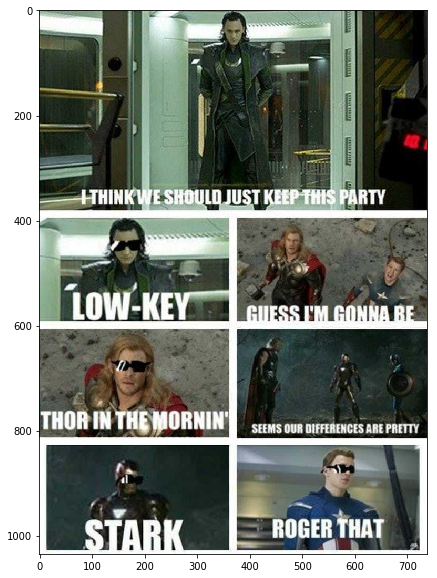

-------------------------------------------------------------------------
# 43
Captain America I had a date I volunteer! 
['captain', 'america', 'i', 'have', 'a', 'date', 'i', 'volunteer']


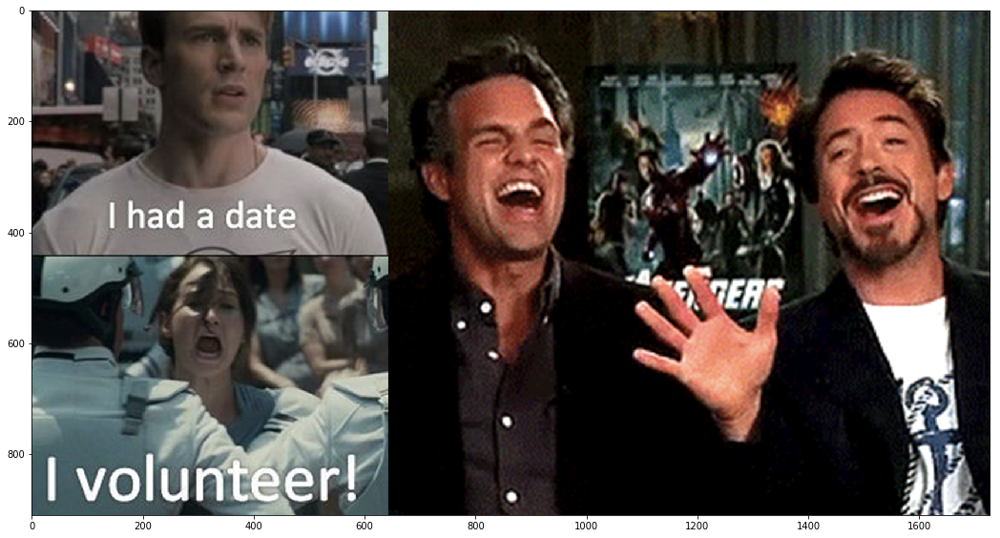

-------------------------------------------------------------------------
# 44
HYPOCRICY KI B KOI SIMA HOTI HAI BHALOBHNO imgflip.com Avengers Thor 
['hypocricy', 'ki', 'b', 'koi', 'sima', 'hoti', 'hai', 'bhalobhno', 'avengers', 'thor']


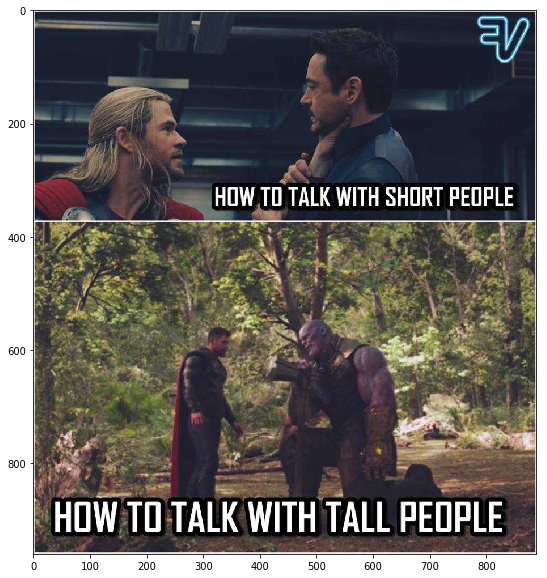

-------------------------------------------------------------------------
# 45
I think I did okay! (EXPLOSION) 
['i', 'think', 'i', 'do', 'okay', 'explosion']


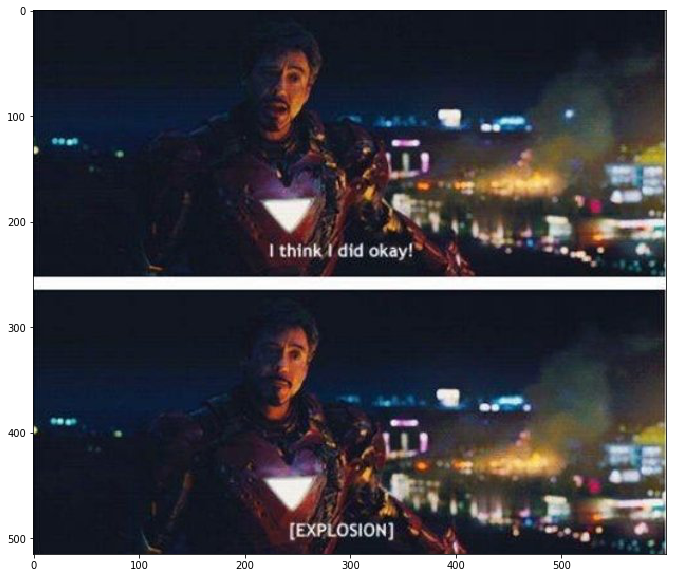

-------------------------------------------------------------------------
# 46
I did not invade Asgard  it's not true  it's bullshit. I did not invade it. I did Naaaaawt. Oh hi Thor. 
['i', 'do', 'not', 'invade', 'asgard', 'its', 'not', 'true', 'its', 'bullshit', 'i', 'do', 'not', 'invade', 'it', 'i', 'do', 'naaaaawt', 'oh', 'hi', 'thor']


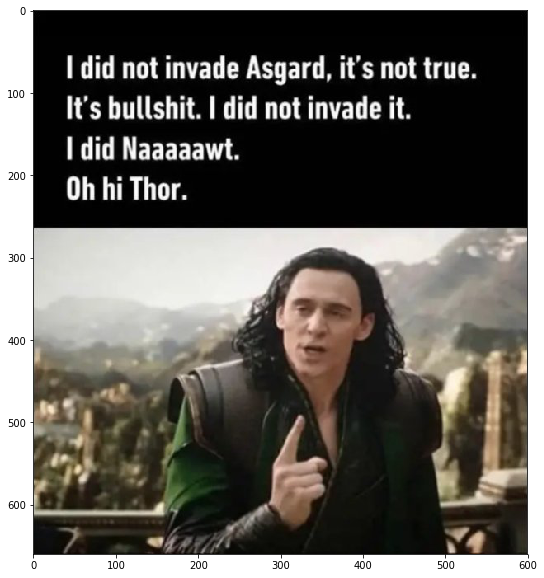

-------------------------------------------------------------------------
# 47
SERIOUSLY  I TOOK 6 OF YOU TO STOP AN ALIEN INVASION? TECHNICALLY IT WAS ONLY TWO OF US. THE OTHER FOUR CONTAINED THE DESTRUCTION OF THE CITY TO A FEW BLOCKS WHILE SAVING HUMAN LIVES. HOW MUCH DAMAGE DID YOU CAUSE BY THE WAY? 
['seriously', 'i', 'take', 'of', 'you', 'to', 'stop', 'an', 'alien', 'invasion', 'technically', 'it', 'be', 'only', 'two', 'of', 'us', 'the', 'other', 'four', 'contain', 'the', 'destruction', 'of', 'the', 'city', 'to', 'a', 'few', 'block', 'while', 'save', 'human', 'live', 'how', 'much', 'damage', 'do', 'you', 'cause', 'by', 'the', 'way']


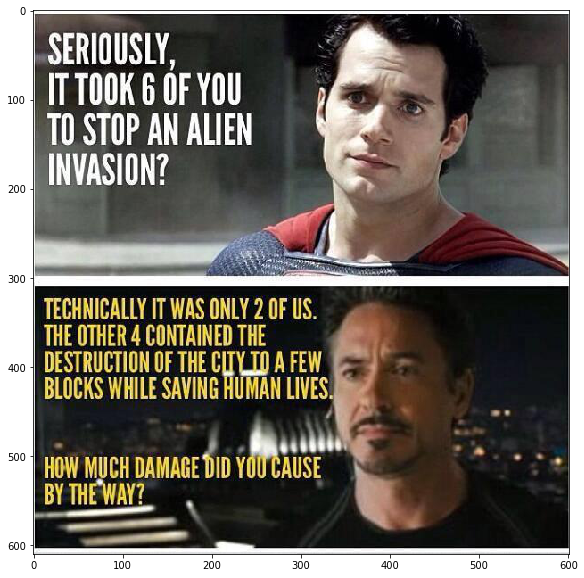

-------------------------------------------------------------------------
# 48
BREAKING AVENGERS ENDGAME EDITING IS COMPLETE  IT IS OFFICIALLY NOW A 3 HOUR MOVIE 
['break', 'avengers', 'endgame', 'edit', 'be', 'complete', 'it', 'be', 'officially', 'now', 'a', 'hour', 'movie']


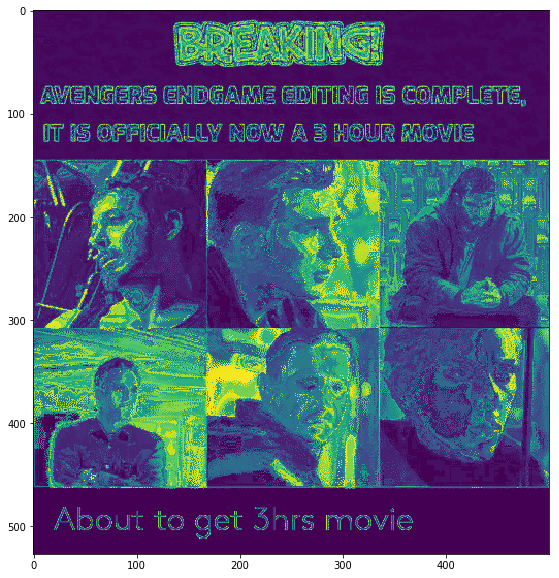

-------------------------------------------------------------------------
# 49
Hawkeye is important in Infinity War Is he though? 
['hawkeye', 'be', 'important', 'in', 'infinity', 'war', 'be', 'he', 'though']


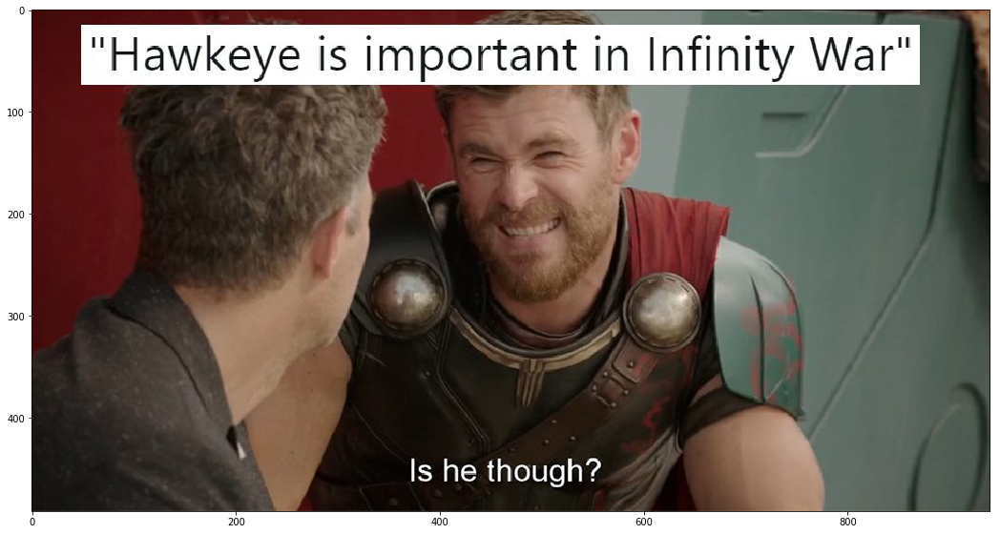

-------------------------------------------------------------------------


In [58]:
# Examine results

desc1 = data.iloc[:, 2]
desc2 = data.iloc[:, 3]

for i in range(50):
    print("#",i)
    text = desc2[i]
    print(text)
    print(clean_text(text))
    print_img(data.iloc[i,0])
    print("-------------------------------------------------------------------------")
    

In [59]:
clean_text_df = pd.DataFrame(np.zeros(len(cdata)), columns=["textArray"], )
clean_text_df = clean_text_df.astype(object)

for i,unclean_text in enumerate(cdata.iloc[:,3]):
    clean_text_df.iloc[i,0] = clean_text(unclean_text)

In [60]:
clean_text_df.head()

,textArray
0,"[look, there, my, friend, lightyear, now, all,..."
1,"[the, best, of, yearchallenge, complete, in, l..."
2,"[sam, thorne, strippin, saw, everyone, post, t..."
3,"[year, challenge, sweet, dee, edition]"
4,"[year, challenge, with, no, filter, hilarious,..."


# Combine all intermediate dataframes into final dataframe

In [380]:
# Creating train_df

new = [
    'clean_text_df',
    'templates_df',
]

old = [
    0,         # File Name
    1,         # File Link 
]

original = pd.concat([cdata[old_idx] for old_idx in old], sort=False, axis=1)#.reset_index()
created = pd.concat([eval(dataframe) for dataframe in new], sort=False, axis=1)
original.columns = ['fileName', 'fileLink']
train_df = pd.concat([original, created], axis=1)

train_df.head()

,fileName,fileLink,textArray,template_10_year,template_avengers,template_baby,template_barney,template_bean,template_best,template_bethe,...,template_sports,template_stevejobs,template_success,template_tech,template_third,template_titanic,template_tom,template_trump,template_x_men,template_zeck
0,10_year_2r94rv.jpg,https://i.imgflip.com/2r94rv.jpg,"[look, there, my, friend, lightyear, now, all,...",1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,10_year_10-year-challenge_1547788782.jpeg,https://spiderimg.amarujala.com/assets/images/...,"[the, best, of, yearchallenge, complete, in, l...",1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,10_year_10yearchallenge-5c75f8b946e0fb0001edc7...,https://www.lifewire.com/thmb/8wNfd94_meE9X2cp...,"[sam, thorne, strippin, saw, everyone, post, t...",1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,10_year_10-year-challenge-sweet-dee-edition-40...,https://pics.conservativememes.com/10-year-cha...,"[year, challenge, sweet, dee, edition]",1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,10_year_10-year-challenge-with-no-filter-47-hi...,https://pics.me.me/10-year-challenge-with-no-f...,"[year, challenge, with, no, filter, hilarious,...",1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [374]:
train_df.columns

Index(['fileName', 'fileLink', 'textArray', 'template_10_year',
       'template_avengers', 'template_baby', 'template_barney',
       'template_bean', 'template_best', 'template_bethe', 'template_big_bang',
       'template_cat_U', 'template_chandler', 'template_chuck',
       'template_country', 'template_deadpool', 'template_decaprio',
       'template_distracted_bf', 'template_dr_evil', 'template_drunk_baby',
       'template_feminist', 'template_friends', 'template_gene', 'template_gf',
       'template_giorgio', 'template_godfather', 'template_got',
       'template_harry', 'template_harvey', 'template_hillary',
       'template_hitler', 'template_jim', 'template_joker', 'template_kim',
       'template_liam', 'template_lor', 'template_minion', 'template_misog',
       'template_modi', 'template_morpheous', 'template_mrbri',
       'template_nemo', 'template_obama', 'template_penguin', 'template_pepe',
       'template_picard', 'template_putin', 'template_racis', 'template_rahul'

In [400]:
# Creating labels_df

new = [
    'labels',
    'hilariousness',
    'intentions',
]

labels_df = pd.concat([eval(dataframe) for dataframe in new], sort=False, axis=1)
labels_df.head()

,Offensiveness,isMotivational,Sentiment,Hilariousness,Intentions
0,0,0,4,3,0
1,0,1,4,0,0
2,0,0,3,2,1
3,2,1,3,2,2
4,2,0,2,3,3


In [402]:
labels_df = labels_df.astype({
    'Offensiveness' : np.int8,
    'isMotivational' : np.int8,
    'Sentiment' : np.int8,
    'Hilariousness' : np.int8,
    'Intentions' : np.int8,
})

labels_df.dtypes

Offensiveness     int8
isMotivational    int8
Sentiment         int8
Hilariousness     int8
Intentions        int8
dtype: object

In [403]:
train_df.to_csv("train.csv")
labels_df.to_csv("label.csv")

# Analysing the clean dataset

In [102]:
train_df = pd.read_csv("train.csv")
labels_df = pd.read_csv("label.csv")

In [62]:
print("BaseLines :")
print(" Offensiveness : {:.4f}".format(len( cdata.iloc[:,6][cdata.iloc[:,6] == 'not_offensive']) / len(cdata)))
print(" isMotivational : {:.4f}".format(len( cdata.iloc[:,7][cdata.iloc[:,7] == 'not_motivational']) / len(cdata)))
print(" Sentiment : {:.4f}".format(len( cdata.iloc[:,8][cdata.iloc[:,8] == 'positive']) / len(cdata)))

BaseLines :
 Offensiveness : 0.3898
 isMotivational : 0.6485
 Sentiment : 0.4466


In [101]:
train_df

,Unnamed: 0,fileName,fileLink,textArray,template_10_year,template_avengers,template_baby,template_barney,template_bean,template_best,...,template_sports,template_stevejobs,template_success,template_tech,template_third,template_titanic,template_tom,template_trump,template_x_men,template_zeck
0,0,10_year_2r94rv.jpg,https://i.imgflip.com/2r94rv.jpg,"['look', 'there', 'my', 'friend', 'lightyear',...",1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,10_year_10-year-challenge_1547788782.jpeg,https://spiderimg.amarujala.com/assets/images/...,"['the', 'best', 'of', 'yearchallenge', 'comple...",1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,10_year_10yearchallenge-5c75f8b946e0fb0001edc7...,https://www.lifewire.com/thmb/8wNfd94_meE9X2cp...,"['sam', 'thorne', 'strippin', 'saw', 'everyone...",1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,3,10_year_10-year-challenge-sweet-dee-edition-40...,https://pics.conservativememes.com/10-year-cha...,"['year', 'challenge', 'sweet', 'dee', 'edition']",1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4,10_year_10-year-challenge-with-no-filter-47-hi...,https://pics.me.me/10-year-challenge-with-no-f...,"['year', 'challenge', 'with', 'no', 'filter', ...",1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6516,6516,best_2017_d2fe668a7ff9227fbb604927de025311.jpg,https://i.pinimg.com/345x/d2/fe/66/d2fe668a7ff...,"['tuesday', 'be', 'mardi', 'gras', 'wednesday'...",0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
6517,6517,best_2017_DR9DnutV4AYK-Pc.jpg,https://pbs.twimg.com/media/DR9DnutV4AYK-Pc.jpg,"['must', 'watch', 'movies', 'of', 'iti', 'chen...",0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
6518,6518,best_2017_less-more-talking-listening-planning...,https://pics.ballmemes.com/less-more-talking-l...,"['less', 'more', 'talk', 'plan', 'soda', 'junk...",0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
6519,6519,best_2017_make-time.jpg,https://arhtisticlicense.files.wordpress.com/2...,"['when', 'i', 'have', 'time', 'be', 'a', 'fant...",0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
